# Projekt 1: Autoenkoder do kolorowania obrazów czarno-białych

Naszym zbiorem wejściowym jest zbiór 1464 zdjęć 9 gatunków ptaków natywnych w Ameryce (podzbiór: https://www.kaggle.com/datasets/gpiosenka/100-bird-species):
- American Avocet
- American Bittern
- American Coot
- American Flamingo
- American Goldfinch    
- American Kestrel
- American Pipit
- American Redstart
- American Wigeon

In [3]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import PIL.Image
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dropout, BatchNormalization, Conv2D, Conv2DTranspose, MaxPooling2D, UpSampling2D, Flatten, Cropping2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import load_img
from keras.regularizers import l2
BATCH_SIZE = 16
STEPS      = np.floor(70626/BATCH_SIZE) 
VAL_STEPS  = np.ceil(2250/BATCH_SIZE) 
STEPS_AMERICA      = np.floor(1464/BATCH_SIZE) 
VAL_STEPS_AMERICA  = np.ceil(45/BATCH_SIZE) 

# Nie dziala :)
#def image224x224Generator(imageDataGenerator):
#    for batch in imageDataGenerator:
#        yield [batch, [224, 224]]

# Wiecej gatunkow ptakow, ale nie ma na to czasu
#trainGenerator = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
#    "train",
#    color_mode='rgb',
#    class_mode='input',
#    batch_size=BATCH_SIZE,
#    target_size=(224, 224),
#    interpolation = 'bilinear',
#   shuffle=True
#)
#trainAmericanGenerator = image224x224Generator(
trainAmericanGenerator = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
    "trainAmerican",
    color_mode='rgb',
    class_mode='input',
    batch_size=BATCH_SIZE,
    target_size=(128, 128),
    interpolation = 'bilinear',
    shuffle=True
)#)

# Wiecej gatunkow ptakow, ale nie ma na to czasu
#validGenerator = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
#    "valid",
#    color_mode='rgb',
#    class_mode='input',
#    batch_size=BATCH_SIZE,
#    target_size=(224, 224),
#    shuffle=True
#)

#validAmericanGenerator = image224x224Generator(
validAmericanGenerator = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
    "validAmerican",
    color_mode='rgb',
    class_mode='input',
    batch_size=BATCH_SIZE,
    target_size=(128, 128),
    interpolation = 'bilinear',
    shuffle=True
)#)

#Lazy mode

# Wiecej gatunkow ptakow, ale nie ma na to czasu
#test = list(ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
#    "test",
#    color_mode='rgb',
#    class_mode=None,
#    batch_size=10,
#    target_size=(224, 224),
#    shuffle=True
#).next())

testAmerican = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
    "testAmerican",
    color_mode='rgb',
    class_mode=None,
    batch_size=16,
    target_size=(128, 128),
    interpolation = 'bilinear',
    shuffle=True
)

testAmericanDrawable = list(testAmerican.next())

pies = load_img(
    "pies.png",
    color_mode='rgb',
    target_size=(64,64),
    interpolation = 'bilinear'
)

kot = load_img(
    "kot.png",
    color_mode='rgb',
    target_size=(90,90),
    interpolation = 'bilinear'
)

zolw = load_img(
    "Żółw.png",
    color_mode='rgb',
    target_size=(200,200),
    interpolation = 'bilinear'
)

Found 1464 images belonging to 9 classes.
Found 45 images belonging to 9 classes.
Found 45 images belonging to 9 classes.


In [4]:
FILTER = 32
#3*3, to jest zmniejszenie feature map w wyniku strides > 2 w warstwach splotowych
MAGIC_NUMBER = 9
IMAGE_SIZE = (128, 128)
def mse(y_true, y_pred):
    #y_true.get_shape() # ofc to tutaj tez nie zadziala :>
    # To tez nie dziala
    #y_pred = tf.image.crop_to_bounding_box(y_pred, 0, 0, y_true.shape[1], y_true.shape[2])
    # Moze tym razem zadziala zmienna globalna?
    global IMAGE_SIZE
    # Czemu to dziala??
    # Ta funkcja nie jest wywolana na GPU i ma dostep do RAMu?
    mod = MAGIC_NUMBER - (IMAGE_SIZE[0] % MAGIC_NUMBER)
    offset1 = 0
    if (mod != MAGIC_NUMBER):
        offset1 = int(mod/2)
    mod = MAGIC_NUMBER - (IMAGE_SIZE[1] % MAGIC_NUMBER)
    offset2 = 0
    if (mod != MAGIC_NUMBER):
        offset2 = int(mod/2)
    y_pred = tf.image.crop_to_bounding_box(y_pred, offset1, offset2, IMAGE_SIZE[0], IMAGE_SIZE[1])
    squared_difference = tf.square(y_true - y_pred)
    return tf.reduce_mean(squared_difference, axis=-1)

class Autoenkoder(Model):
    # Nie dziala :>
    #def resize(self, size1, size2):
    #    global MAGIC_NUMBER
    #    self.size1.assign(size1)
    #    self.size2.assign(size2)
    def __init__(self, dropout_scale = 1, momentum = 0.95, weight_decay = 0):
        super().__init__(name="Autoenkoder")
        #self.size1 = size1 #tf.Variable(size1)
        #self.size2 = size2 #tf.Variable(size2)
        self.network = []
        # ENKODER
        self.network.append(Conv2D(filters=FILTER, kernel_size=3, strides=1, activation='relu', padding='same', data_format='channels_last', kernel_regularizer=l2(weight_decay)))
        self.network.append(BatchNormalization(momentum = momentum))
        # MaxPool wydaje sie byc slaby dla autoenkodera
        #self.network.append(MaxPooling2D(pool_size=2, strides=2))
        # Dropout dla CNN powinien byc stosunkowo maly
        self.network.append(Dropout(0.05 * dropout_scale))

        self.network.append(Conv2D(filters=FILTER*2, kernel_size=3, strides=2, activation='relu', padding='same', data_format='channels_last', kernel_regularizer=l2(weight_decay)))
        self.network.append(BatchNormalization(momentum = momentum))
        self.network.append(Dropout(0.025 * dropout_scale))
        
        self.network.append(Conv2D(filters=FILTER*4, kernel_size=5, strides=3, activation='relu', padding='same', data_format='channels_last', kernel_regularizer=l2(weight_decay)))
        self.network.append(BatchNormalization(momentum = momentum))
        self.network.append(Dropout(0.01 * dropout_scale))
        
        # Czy output Enkodera powinien byc normalizowany, etc.?
        self.network.append(Conv2D(filters=FILTER*8, kernel_size=5, strides=3, activation='relu', padding='same', data_format='channels_last'))
        
        # DEKODER
        self.network.append(Conv2DTranspose(filters=FILTER*8, kernel_size=5, strides=3, activation='relu', padding='same', data_format='channels_last', kernel_regularizer=l2(weight_decay)))
        self.network.append(BatchNormalization(momentum = momentum))
        self.network.append(Dropout(0.05 * dropout_scale))

        self.network.append(Conv2DTranspose(filters=FILTER*4, kernel_size=5, strides=3, activation='relu', padding='same', data_format='channels_last', kernel_regularizer=l2(weight_decay)))
        self.network.append(BatchNormalization(momentum = momentum))
        self.network.append(Dropout(0.025 * dropout_scale))
        
        self.network.append(Conv2DTranspose(filters=FILTER*2, kernel_size=3, strides=2, activation='relu', padding='same', data_format='channels_last', kernel_regularizer=l2(weight_decay)))
        self.network.append(BatchNormalization(momentum = momentum))
        self.network.append(Dropout(0.01 * dropout_scale))
        #self.network.append(UpSampling2D(size=(2,2)))

        self.network.append(Conv2DTranspose(filters=FILTER, kernel_size=3, strides=1, activation='sigmoid', padding='same', data_format='channels_last'))
       
        # Teoretycznie to jest dopiero output Dekodera, ale to tylko dlatego, ze trzeba wyluskac RGB. Czy to pozwala nam zastosowac normalizacje, dropout i weight decay na warstwie wyzej?
        self.network.append(Conv2D(filters=3, kernel_size=3, activation='sigmoid', padding='same', data_format='channels_last'))

    def call(self, data):
        #shape = data.get_shape() #Czasami dziala, ale wiekszosc razy nie :]
        #self.size1 i self.size2 nie da siec updateowac c:
        # Zmiene globalne tez nie dzialaja!!
        # Dodanie klasy generujacej liste z dwoma elemetami: batch i rozmiar obrazku, a potem zdefiniowanie wlasnej funkcji straty tez nie dziala (to wydawalo sie byc fail proof, no ale wywala sie juz na pierwszym kroku...)
        # Na razie jedyny znany nam sposob na to, zeby dalo sie wrzucic obraz o dowolnym rozmiarze to skonstruowanie takiej sieci, ktora nie posiada stride > 2 oraz nie posiada zadnego poolingu
        # Taki siecie sa nudne i wolimy dostac gorsza ocene niz takie cos zrobic
        # Nasze poszukiwania rozwiazania lub chociaz workarounda nie przyniosly rezultatow
        # Moze bysmy je kontynuowali, gdyby nie fakt, ze obecny semestr jest semestrem dyplomowym
        
        #mod = MAGIC_NUMBER - (self.size1 % MAGIC_NUMBER)
        #offset1     = 0
        #targetSize1 = shape[0]
        #if (mod != MAGIC_NUMBER):
        #    offset1 = int(mod/2)
        #    targetSize1 = targetSize1 + mod
        #mod = MAGIC_NUMBER - (shape[1] % MAGIC_NUMBER)
        #offset2     = 0w
        #targetSize2 = shape[1]
        #if (mod != MAGIC_NUMBER):
        #    offset2 = int(mod/2)
        #    targetSize2 = targetSize2 + mod
        data = tf.image.rgb_to_grayscale(data)
        #data = tf.image.pad_to_bounding_box(data, offset1, offset2, targetSize1, targetSize2)
        for layer in self.network:
            data = layer(data)
        # Bez tego jest retracing, ale coz...
        #data = tf.image.crop_to_bounding_box(data, offset1, offset2, shape[0], shape[1])
        return data

In [5]:
def test(colorWizard):
    global IMAGE_SIZE
    results = colorWizard.evaluate(testAmerican)
    print("test loss, test acc:", results)

    def draw(img):
        fig, axes = plt.subplots(ncols=3)
        axes[0].imshow(tf.image.rgb_to_grayscale(img), cmap='gray')
        axes[0].set_xlabel("Input")
        axes[1].imshow(colorWizard.predict(np.array([img]))[0, :IMAGE_SIZE[0], :IMAGE_SIZE[1], :])
        axes[1].set_xlabel("Output")
        axes[2].imshow(img)
        axes[2].set_xlabel("Excepted")

    for i in range(10):
        draw(testAmericanDrawable[i])

    IMAGE_SIZE = (64,64)
    draw(np.array(pies)/255)
    IMAGE_SIZE = (90,90)
    draw(np.array(kot)/255)
    IMAGE_SIZE = (200,200)
    draw(np.array(zolw)/255)
    IMAGE_SIZE = (128,128)

# Model wstępny
Z bliżej nieokreślonych powodów metoda `model.evaluate(test_set)` nie działa. Najprawdopodobniej musielibyśmy zdefiniować w modelu **krok testu** (i podać właściwą **funkcję straty**). Nie mniej jednak do naszego oszacowania jakości wystarczy parametr `val_loss` oraz bardziej ,,ludzkie'', subiektywne sposoby klasyfikacji jakości: ciągłość kolorów, plamistość obrazu etc.

In [4]:
colorWizard1 = Autoenkoder()
colorWizard1.compile(optimizer=Adam(0.006), loss=mse)

In [5]:
print("40/160")
_ = colorWizard1.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=40, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

40/160
Epoch 1/40
91/91 [==============================] - 27s 266ms/step - loss: 0.0278 - val_loss: 0.0219 - lr: 0.0060
Epoch 2/40
91/91 [==============================] - 22s 241ms/step - loss: 0.0168 - val_loss: 0.0233 - lr: 0.0060
Epoch 3/40
91/91 [==============================] - 22s 242ms/step - loss: 0.0151 - val_loss: 0.0152 - lr: 0.0060
Epoch 4/40
91/91 [==============================] - 22s 245ms/step - loss: 0.0139 - val_loss: 0.0161 - lr: 0.0060
Epoch 5/40
91/91 [==============================] - 22s 244ms/step - loss: 0.0127 - val_loss: 0.0191 - lr: 0.0060
Epoch 6/40
91/91 [==============================] - 22s 244ms/step - loss: 0.0120 - val_loss: 0.0161 - lr: 0.0060
Epoch 7/40
91/91 [==============================] - 22s 245ms/step - loss: 0.0122 - val_loss: 0.0121 - lr: 0.0060
Epoch 8/40
91/91 [==============================] - 22s 246ms/step - loss: 0.0115 - val_loss: 0.0124 - lr: 0.0060
Epoch 9/40
91/91 [==============================] - 22s 246ms/step - loss: 0.0114

3/3 [==============================] - 0s 22ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 350ms/step


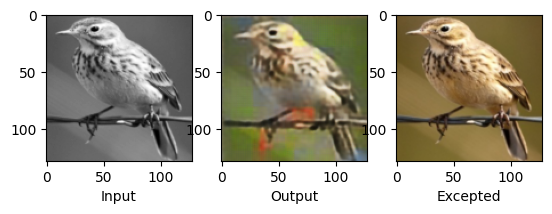

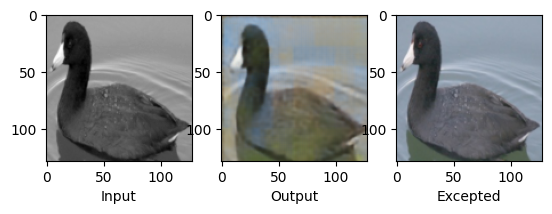

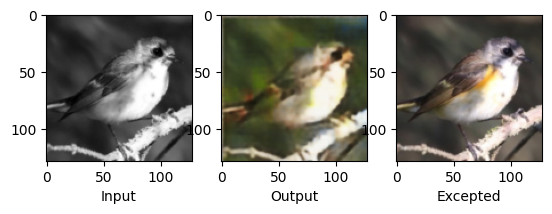

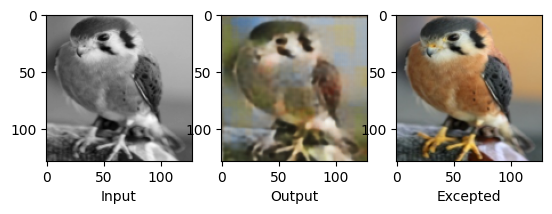

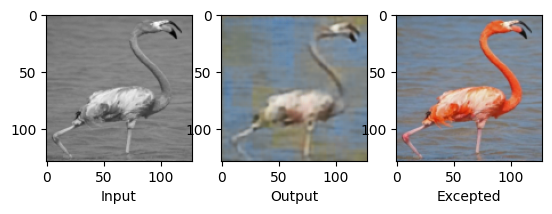

...

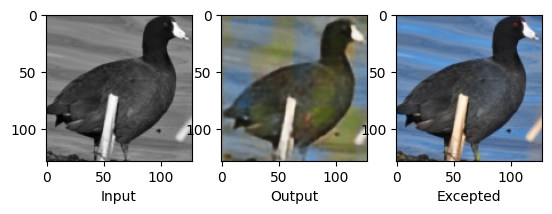

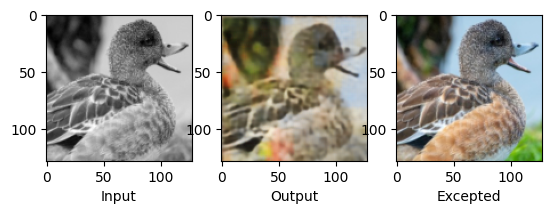

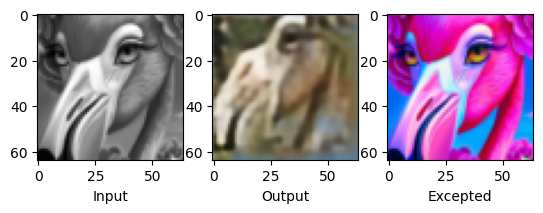

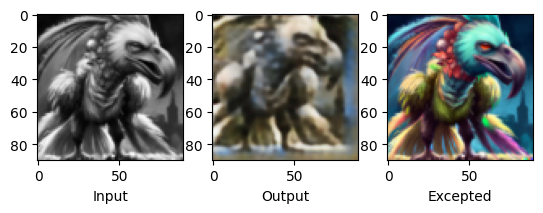

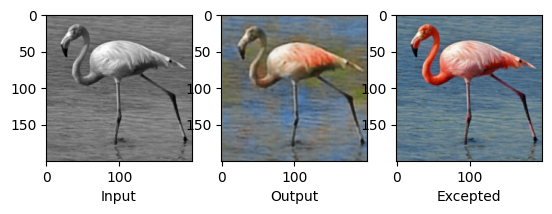

In [6]:
test(colorWizard1)

In [7]:
print("80/160")
_ = colorWizard1.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=40, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

80/160
Epoch 1/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0045 - val_loss: 0.0095 - lr: 0.0026
Epoch 2/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0045 - val_loss: 0.0098 - lr: 0.0026
Epoch 3/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0046 - val_loss: 0.0096 - lr: 0.0026
Epoch 4/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0045 - val_loss: 0.0091 - lr: 0.0026
Epoch 5/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0044 - val_loss: 0.0101 - lr: 0.0026
Epoch 6/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0044 - val_loss: 0.0093 - lr: 0.0026
Epoch 7/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0041 - val_loss: 0.0091 - lr: 0.0026
Epoch 8/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0043 - val_loss: 0.0099 - lr: 0.0026
Epoch 9/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0042

3/3 [==============================] - 0s 23ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 23ms/step


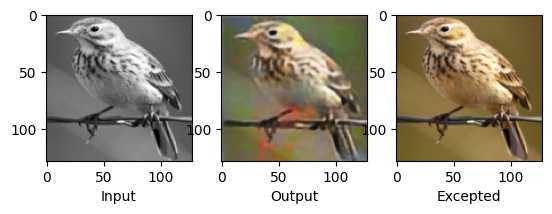

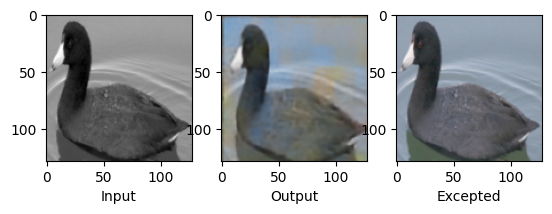

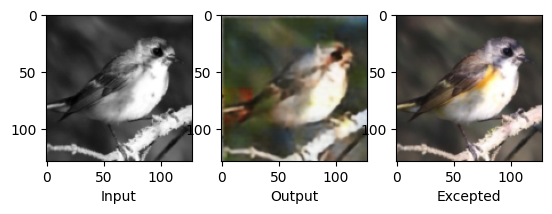

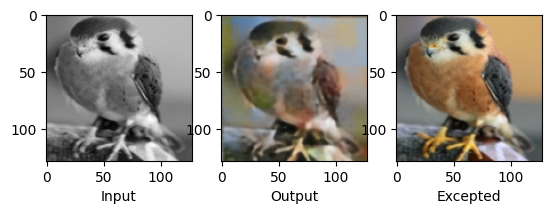

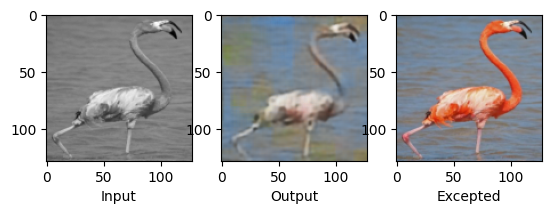

...

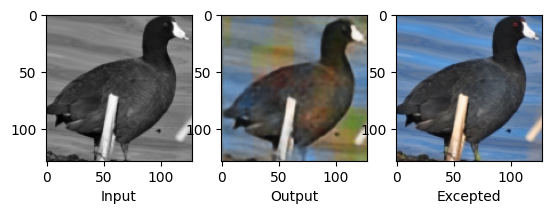

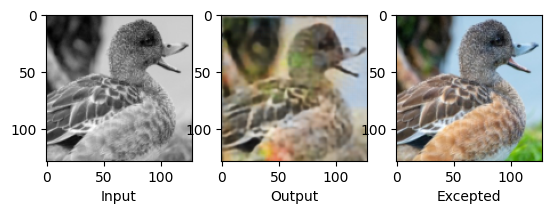

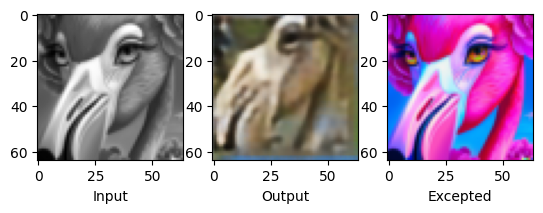

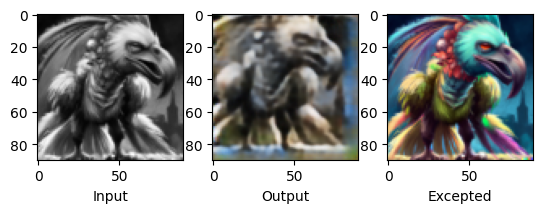

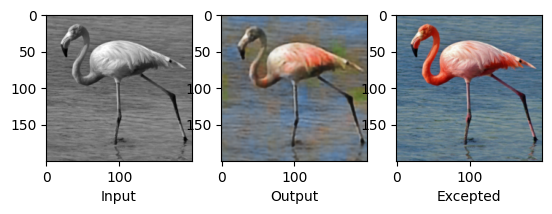

In [8]:
test(colorWizard1)

In [9]:
print("120/160")
_ = colorWizard1.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=40, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

120/160
Epoch 1/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0030 - val_loss: 0.0093 - lr: 4.9592e-04
Epoch 2/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0030 - val_loss: 0.0095 - lr: 4.9592e-04
Epoch 3/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0029 - val_loss: 0.0096 - lr: 4.9592e-04
Epoch 4/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0030 - val_loss: 0.0092 - lr: 4.9592e-04
Epoch 5/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0029 - val_loss: 0.0093 - lr: 4.9592e-04
Epoch 6/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0029 - val_loss: 0.0094 - lr: 4.9592e-04
Epoch 7/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0029 - val_loss: 0.0093 - lr: 4.9592e-04
Epoch 8/40
91/91 [==============================] - 22s 239ms/step - loss: 0.0029 - val_loss: 0.0093 - lr: 4.9592e-04
Epoch 9/40
91/91 [==============================

3/3 [==============================] - 0s 24ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 27ms/step


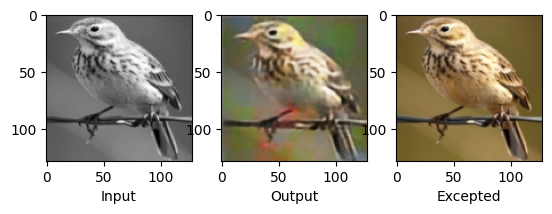

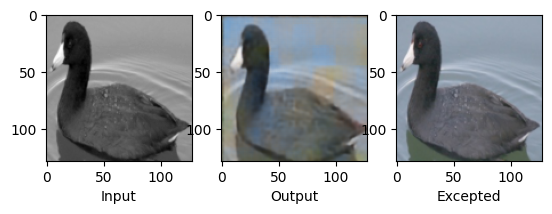

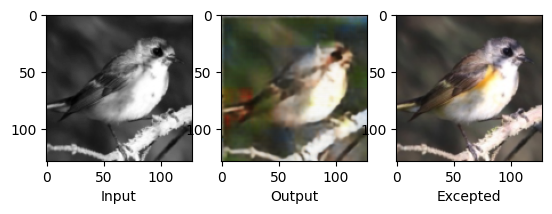

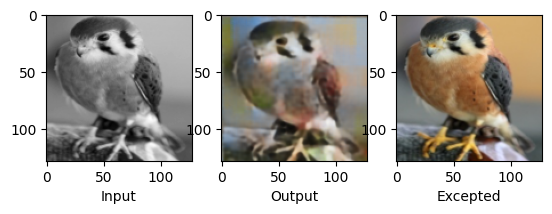

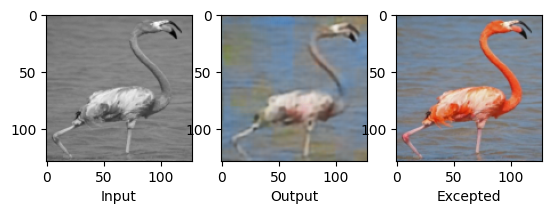

...

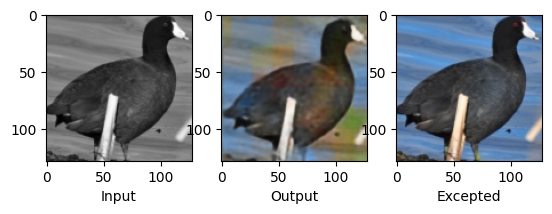

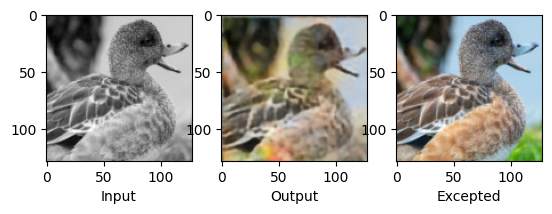

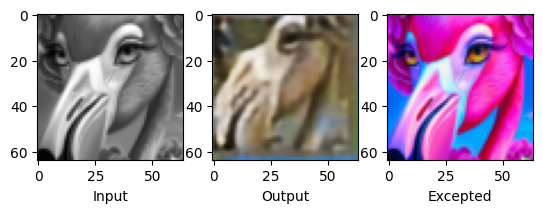

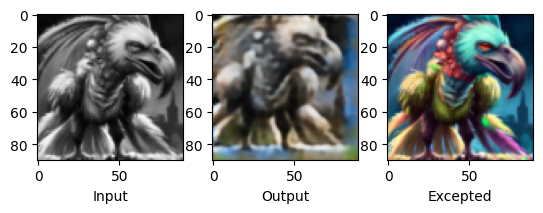

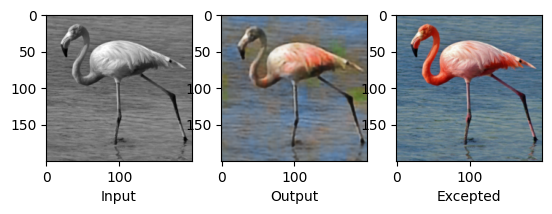

In [10]:
test(colorWizard1)

In [11]:
print("160/160")
_ = colorWizard1.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=40, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

160/160
Epoch 1/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0026 - val_loss: 0.0092 - lr: 9.4100e-05
Epoch 2/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0027 - val_loss: 0.0092 - lr: 9.4100e-05
Epoch 3/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0027 - val_loss: 0.0092 - lr: 9.4100e-05
Epoch 4/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0027 - val_loss: 0.0092 - lr: 9.4100e-05
Epoch 5/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0027 - val_loss: 0.0092 - lr: 9.4100e-05
Epoch 6/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0026 - val_loss: 0.0092 - lr: 9.4100e-05
Epoch 7/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0027 - val_loss: 0.0092 - lr: 9.4100e-05
Epoch 8/40
91/91 [==============================] - 22s 240ms/step - loss: 0.0026 - val_loss: 0.0093 - lr: 9.4100e-05
Epoch 9/40
91/91 [==============================

3/3 [==============================] - 0s 23ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 25ms/step


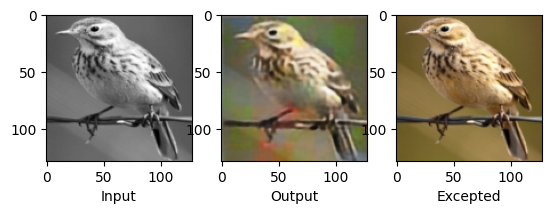

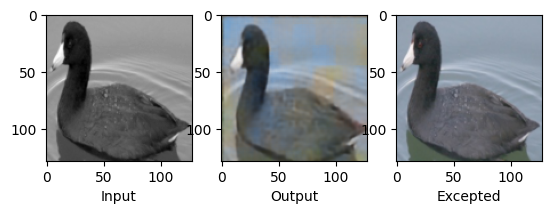

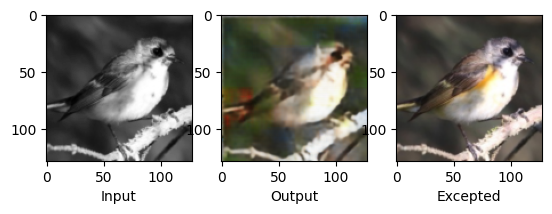

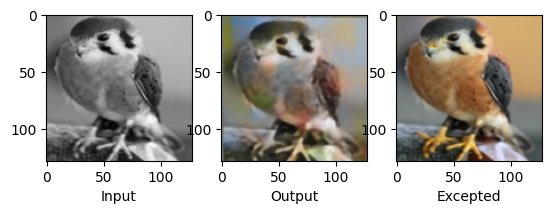

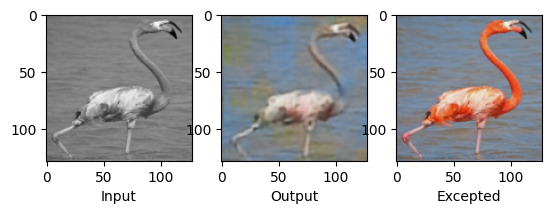

...

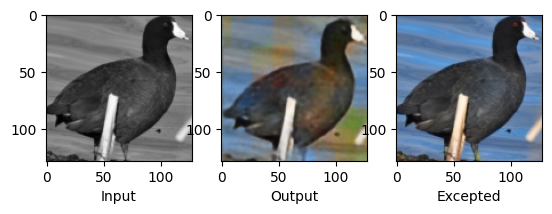

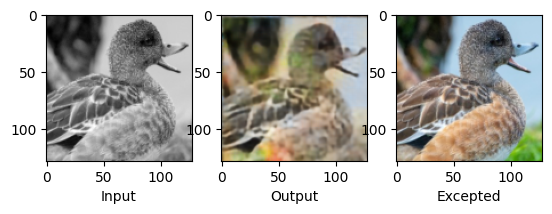

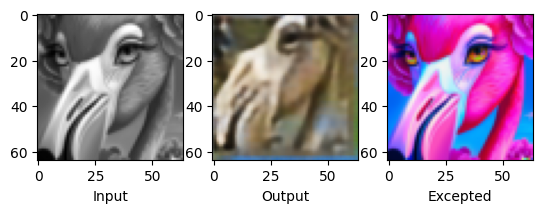

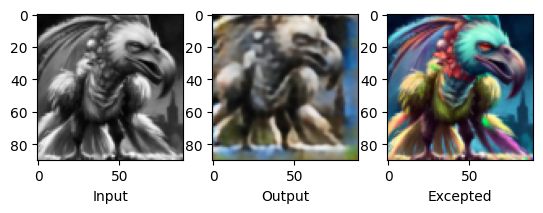

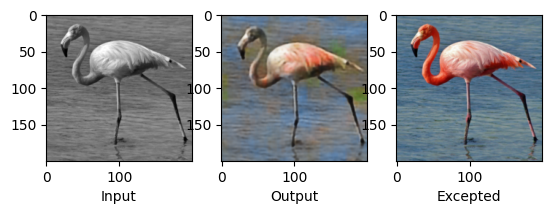

In [12]:
test(colorWizard1)

### Kometarz
Wynik jest nieco plamisty, jest to najprawdopodobniej wynik dobrania nie najlepszej struktury sieci. Lekkie rozmazanie wynika z pomniejszenia mapy cech 9-krotnie podczas przetwarzania. Gdyby specyfikacja zadania była inna i nie było wymagane zwracanie 3 kanałów, to nasz program operował by tylko na hue, co by zachowało ostrość obrazu. Zdjęcia o niestandardowych rozmiarach są przycinane w nieodpowiedni sposób, ale nie ma tragedii:<br>
`y_pred = tf.image.crop_to_bounding_box(y_pred, offset1, offset2, IMAGE_SIZE[0], IMAGE_SIZE[1])`<br>
To wydaje się być poprawne, może uczymy sieć w zły sposób i powinniśmy przetwarzać input zamiast outputu? Nie znaleźliśmy odpowiedzi na te pytanie (w komentarzach modelu zawarliśmy nasze nieudane próby owego przetwarzania). Przekazywanie obrazów o dowolnym rozmiarze jest możliwe, mimo powstania tych defektów.

# Dropout:
### Droput x 2:

In [13]:
colorWizard2 = Autoenkoder(2)
colorWizard2.compile(optimizer=Adam(0.006), loss=mse)

In [14]:
_ = colorWizard2.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
91/91 [==============================] - 24s 247ms/step - loss: 0.0294 - val_loss: 0.0198 - lr: 0.0060
Epoch 2/160
91/91 [==============================] - 22s 240ms/step - loss: 0.0178 - val_loss: 0.0167 - lr: 0.0060
Epoch 3/160
91/91 [==============================] - 22s 240ms/step - loss: 0.0160 - val_loss: 0.0148 - lr: 0.0060
Epoch 4/160
91/91 [==============================] - 22s 240ms/step - loss: 0.0139 - val_loss: 0.0128 - lr: 0.0060
Epoch 5/160
91/91 [==============================] - 22s 240ms/step - loss: 0.0148 - val_loss: 0.0218 - lr: 0.0060
Epoch 6/160
91/91 [==============================] - 22s 240ms/step - loss: 0.0126 - val_loss: 0.0119 - lr: 0.0060
Epoch 7/160
91/91 [==============================] - 22s 240ms/step - loss: 0.0118 - val_loss: 0.0115 - lr: 0.0060
Epoch 8/160
91/91 [==============================] - 22s 241ms/step - loss: 0.0115 - val_loss: 0.0114 - lr: 0.0060
Epoch 9/160
91/91 [==============================] - 22s 241ms/step - loss: 0.01

3/3 [==============================] - 0s 22ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 23ms/step


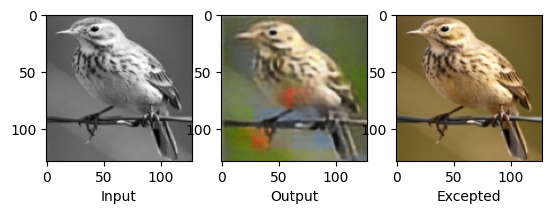

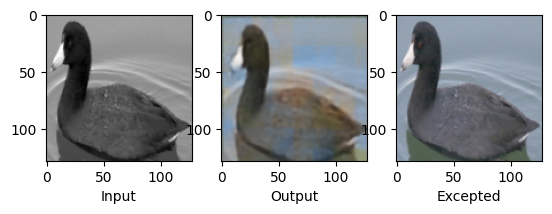

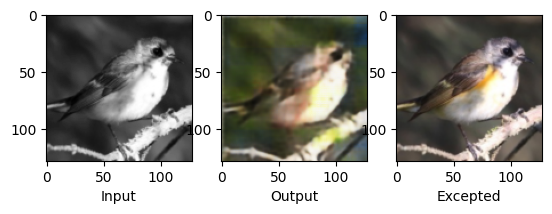

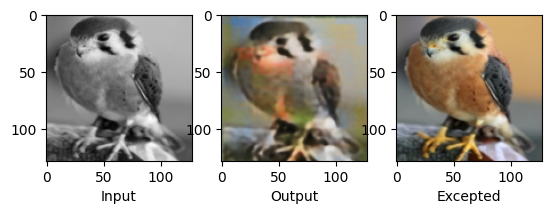

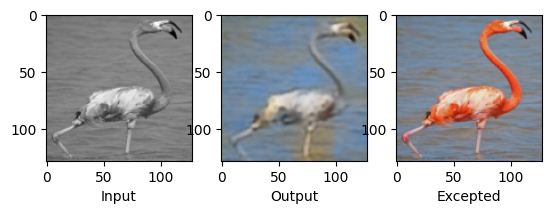

...

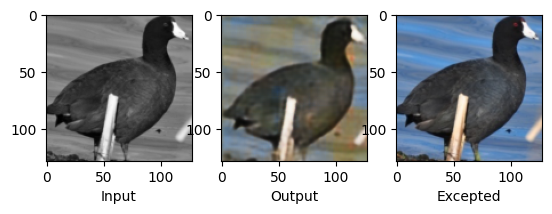

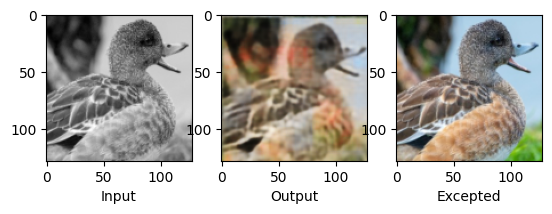

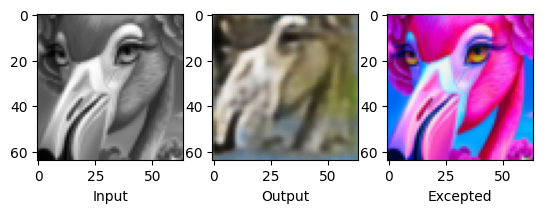

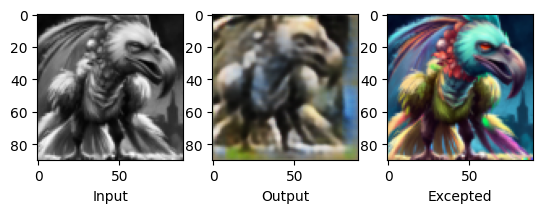

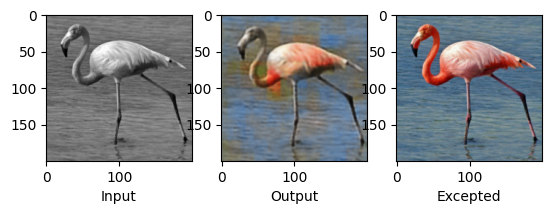

In [15]:
test(colorWizard2)

### Dropout x 4:

In [16]:
colorWizard3 = Autoenkoder(4)
colorWizard3.compile(optimizer=Adam(0.006), loss=mse)

In [17]:
_ = colorWizard3.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
91/91 [==============================] - 24s 247ms/step - loss: 0.0253 - val_loss: 0.0185 - lr: 0.0060
Epoch 2/160
91/91 [==============================] - 22s 238ms/step - loss: 0.0172 - val_loss: 0.0152 - lr: 0.0060
Epoch 3/160
91/91 [==============================] - 22s 238ms/step - loss: 0.0158 - val_loss: 0.0146 - lr: 0.0060
Epoch 4/160
91/91 [==============================] - 22s 241ms/step - loss: 0.0141 - val_loss: 0.0157 - lr: 0.0060
Epoch 5/160
91/91 [==============================] - 22s 241ms/step - loss: 0.0148 - val_loss: 0.0133 - lr: 0.0060
Epoch 6/160
91/91 [==============================] - 22s 243ms/step - loss: 0.0133 - val_loss: 0.0129 - lr: 0.0060
Epoch 7/160
91/91 [==============================] - 22s 246ms/step - loss: 0.0128 - val_loss: 0.0125 - lr: 0.0060
Epoch 8/160
91/91 [==============================] - 22s 244ms/step - loss: 0.0123 - val_loss: 0.0134 - lr: 0.0060
Epoch 9/160
91/91 [==============================] - 22s 244ms/step - loss: 0.01

3/3 [==============================] - 0s 21ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 24ms/step


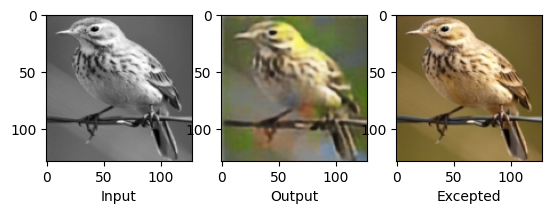

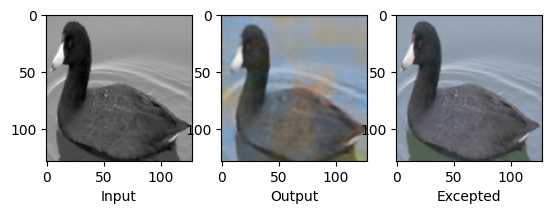

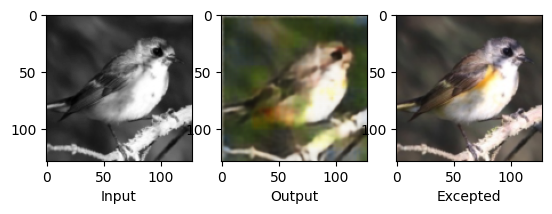

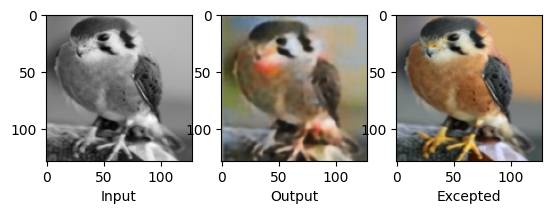

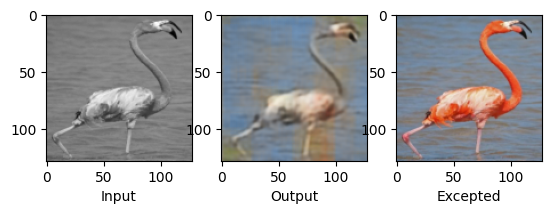

...

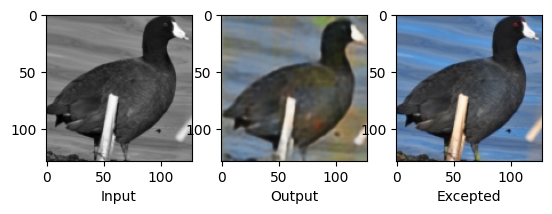

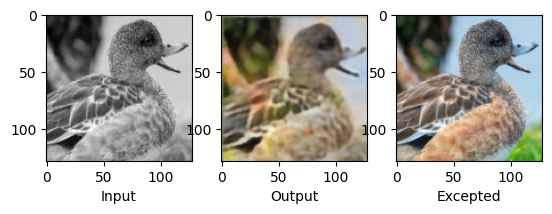

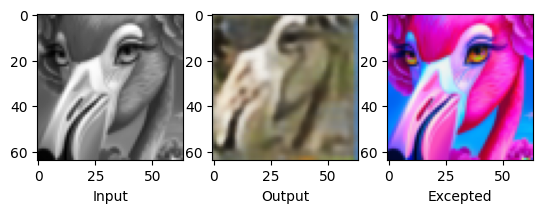

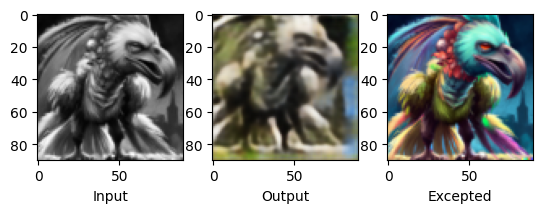

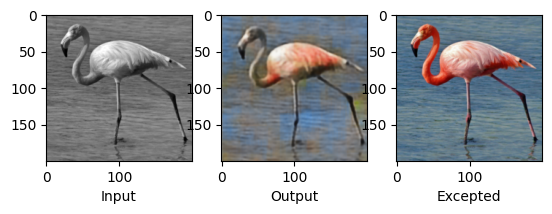

In [18]:
test(colorWizard3)

### Komentarz
Mimo, że wartości `val_loss` dropout x2 i dropout x4 są zbliżone, zwiększenie dropouta do x4 zmniejsza plamistość zdjęć. Dalsze zwiększanie przekroczyłoby próg 0.2, co jest zalecanym maksymalnym dla CNN.

# Batch:
### Batch 8:

In [3]:
BATCH_SIZE = 8
STEPS      = np.floor(70626/BATCH_SIZE) 
VAL_STEPS  = np.ceil(2250/BATCH_SIZE) 
STEPS_AMERICA      = np.floor(1464/BATCH_SIZE) 
VAL_STEPS_AMERICA  = np.ceil(45/BATCH_SIZE) 

trainAmericanGenerator = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
    "trainAmerican",
    color_mode='rgb',
    class_mode='input',
    batch_size=BATCH_SIZE,
    target_size=(128, 128),
    interpolation = 'bilinear',
    shuffle=True
)
validAmericanGenerator = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
    "validAmerican",
    color_mode='rgb',
    class_mode='input',
    batch_size=BATCH_SIZE,
    target_size=(128, 128),
    interpolation = 'bilinear',
    shuffle=True
)

Found 1464 images belonging to 9 classes.
Found 45 images belonging to 9 classes.


In [4]:
colorWizard4 = Autoenkoder(4)
colorWizard4.compile(optimizer=Adam(0.006), loss=mse)

In [5]:
_ = colorWizard4.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
183/183 [==============================] - 29s 139ms/step - loss: 0.0229 - val_loss: 0.0155 - lr: 0.0060
Epoch 2/160
183/183 [==============================] - 25s 134ms/step - loss: 0.0162 - val_loss: 0.0146 - lr: 0.0060
Epoch 3/160
183/183 [==============================] - 25s 134ms/step - loss: 0.0147 - val_loss: 0.0125 - lr: 0.0060
Epoch 4/160
183/183 [==============================] - 25s 134ms/step - loss: 0.0136 - val_loss: 0.0116 - lr: 0.0060
Epoch 5/160
183/183 [==============================] - 25s 135ms/step - loss: 0.0132 - val_loss: 0.0129 - lr: 0.0060
Epoch 6/160
183/183 [==============================] - 25s 135ms/step - loss: 0.0123 - val_loss: 0.0113 - lr: 0.0060
Epoch 7/160
183/183 [==============================] - 25s 138ms/step - loss: 0.0120 - val_loss: 0.0124 - lr: 0.0060
Epoch 8/160
183/183 [==============================] - 25s 135ms/step - loss: 0.0115 - val_loss: 0.0107 - lr: 0.0060
Epoch 9/160
183/183 [==============================] - 25s 135ms

3/3 [==============================] - 1s 28ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 343ms/step


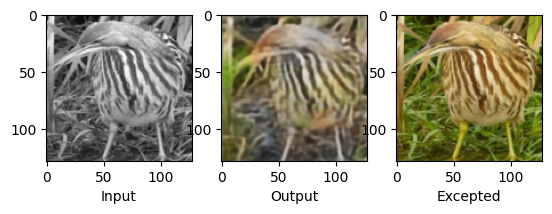

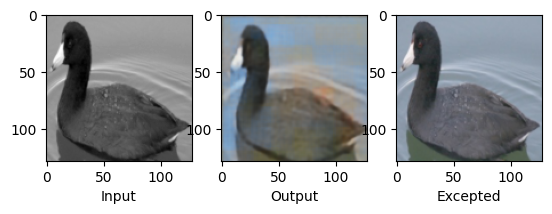

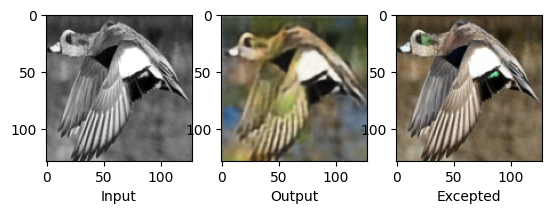

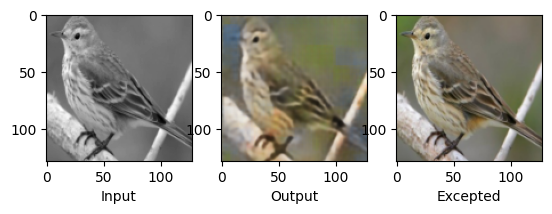

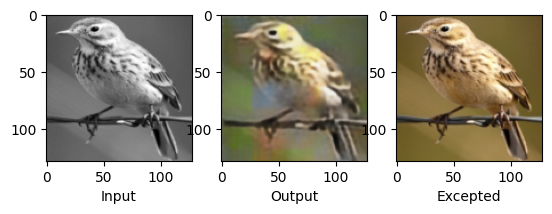

...

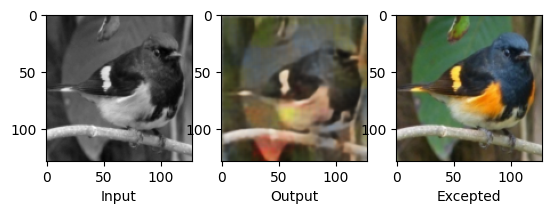

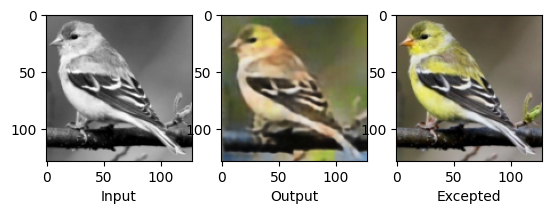

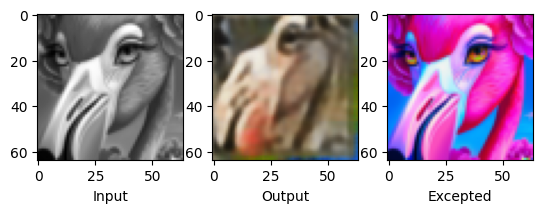

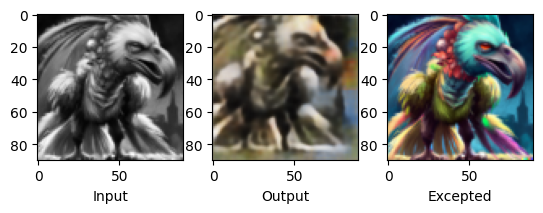

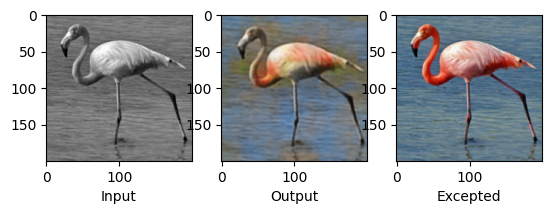

In [8]:
test(colorWizard4)

### Batch 32:

In [9]:
BATCH_SIZE = 32
STEPS      = np.floor(70626/BATCH_SIZE) 
VAL_STEPS  = np.ceil(2250/BATCH_SIZE) 
STEPS_AMERICA      = np.floor(1464/BATCH_SIZE) 
VAL_STEPS_AMERICA  = np.ceil(45/BATCH_SIZE) 

trainAmericanGenerator = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
    "trainAmerican",
    color_mode='rgb',
    class_mode='input',
    batch_size=BATCH_SIZE,
    target_size=(128, 128),
    interpolation = 'bilinear',
    shuffle=True
)
validAmericanGenerator = ImageDataGenerator(rescale=1./255, data_format='channels_last').flow_from_directory(
    "validAmerican",
    color_mode='rgb',
    class_mode='input',
    batch_size=BATCH_SIZE,
    target_size=(128, 128),
    interpolation = 'bilinear',
    shuffle=True
)

Found 1464 images belonging to 9 classes.
Found 45 images belonging to 9 classes.


In [10]:
colorWizard5 = Autoenkoder(4)
colorWizard5.compile(optimizer=Adam(0.006), loss=mse)

In [11]:
_ = colorWizard5.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
45/45 [==============================] - 28s 545ms/step - loss: 0.0301 - val_loss: 0.0331 - lr: 0.0060
Epoch 2/160
45/45 [==============================] - 21s 465ms/step - loss: 0.0176 - val_loss: 0.0227 - lr: 0.0060
Epoch 3/160
45/45 [==============================] - 22s 479ms/step - loss: 0.0154 - val_loss: 0.0158 - lr: 0.0060
Epoch 4/160
45/45 [==============================] - 21s 476ms/step - loss: 0.0146 - val_loss: 0.0147 - lr: 0.0060
Epoch 5/160
45/45 [==============================] - 21s 472ms/step - loss: 0.0136 - val_loss: 0.0140 - lr: 0.0060
Epoch 6/160
45/45 [==============================] - 21s 471ms/step - loss: 0.0133 - val_loss: 0.0140 - lr: 0.0060
Epoch 7/160
45/45 [==============================] - 21s 471ms/step - loss: 0.0125 - val_loss: 0.0137 - lr: 0.0060
Epoch 8/160
45/45 [==============================] - 21s 471ms/step - loss: 0.0126 - val_loss: 0.0133 - lr: 0.0060
Epoch 9/160
45/45 [==============================] - 21s 470ms/step - loss: 0.01

3/3 [==============================] - 0s 19ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 21ms/step


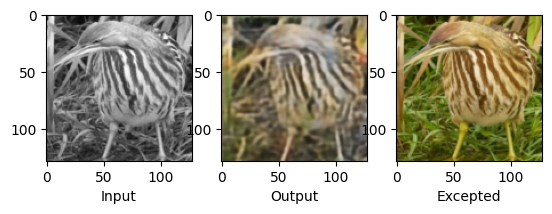

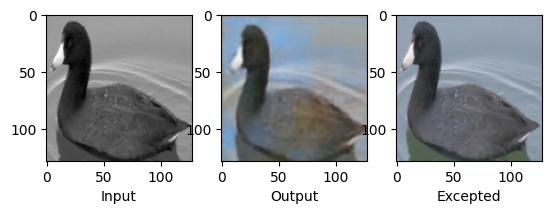

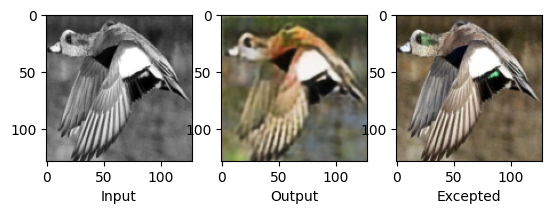

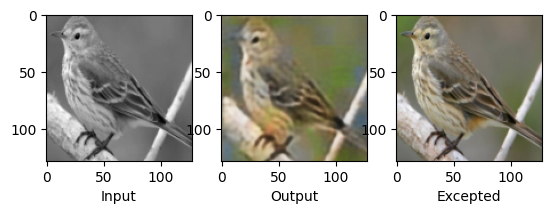

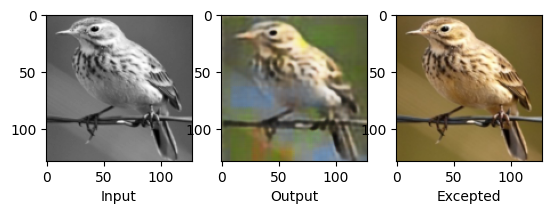

...

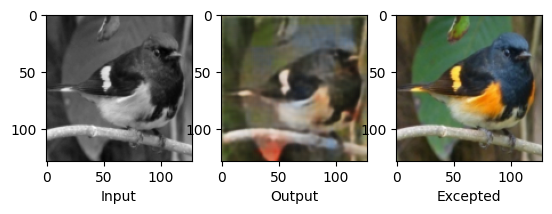

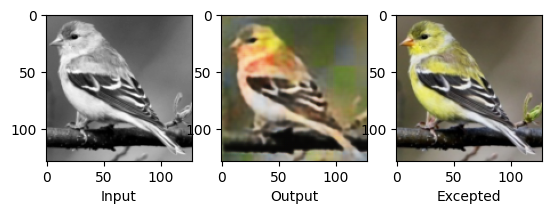

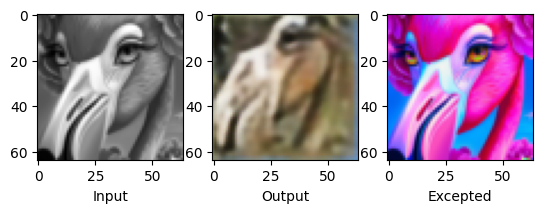

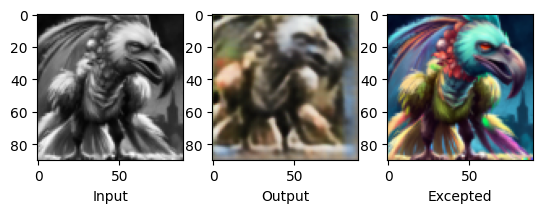

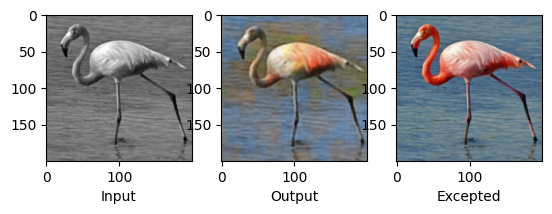

In [12]:
test(colorWizard5)

### Komentarz
Bardziej jednolite, bieremy

### Momentum 0.9:

In [16]:
colorWizard6 = Autoenkoder(4, 0.9)
colorWizard6.compile(optimizer=Adam(0.006), loss=mse)

In [17]:
_ = colorWizard6.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
45/45 [==============================] - 24s 488ms/step - loss: 0.0289 - val_loss: 0.0223 - lr: 0.0060
Epoch 2/160
45/45 [==============================] - 21s 466ms/step - loss: 0.0191 - val_loss: 0.0180 - lr: 0.0060
Epoch 3/160
45/45 [==============================] - 21s 467ms/step - loss: 0.0177 - val_loss: 0.0168 - lr: 0.0060
Epoch 4/160
45/45 [==============================] - 21s 468ms/step - loss: 0.0167 - val_loss: 0.0152 - lr: 0.0060
Epoch 5/160
45/45 [==============================] - 21s 469ms/step - loss: 0.0157 - val_loss: 0.0175 - lr: 0.0060
Epoch 6/160
45/45 [==============================] - 21s 469ms/step - loss: 0.0146 - val_loss: 0.0139 - lr: 0.0060
Epoch 7/160
45/45 [==============================] - 21s 469ms/step - loss: 0.0139 - val_loss: 0.0136 - lr: 0.0060
Epoch 8/160
45/45 [==============================] - 21s 470ms/step - loss: 0.0128 - val_loss: 0.0133 - lr: 0.0060
Epoch 9/160
45/45 [==============================] - 21s 469ms/step - loss: 0.01

3/3 [==============================] - 1s 43ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 29ms/step


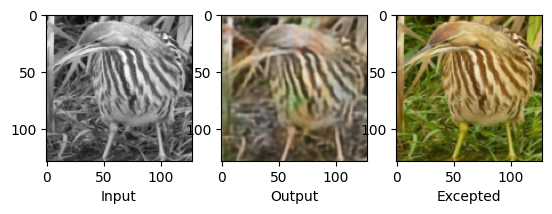

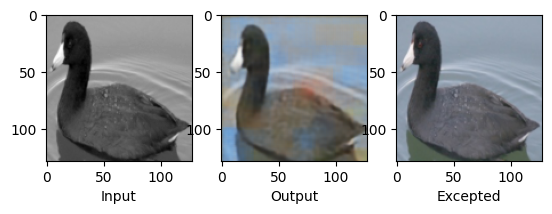

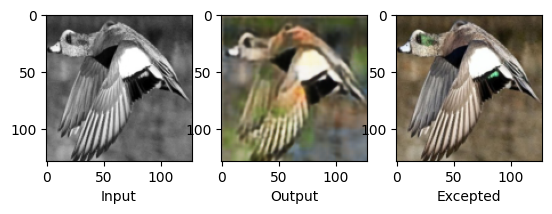

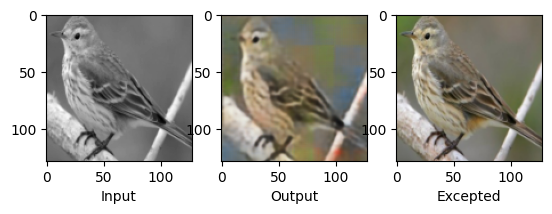

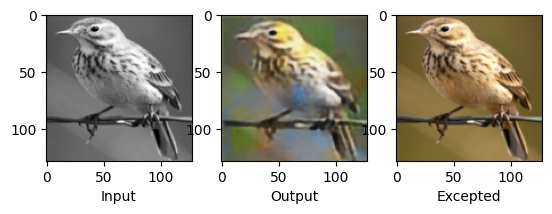

...

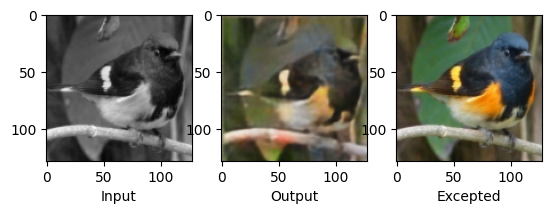

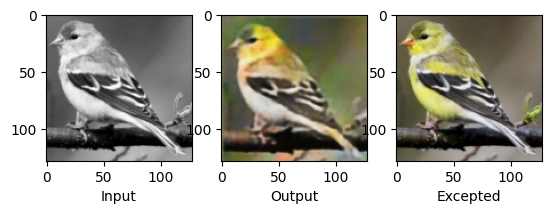

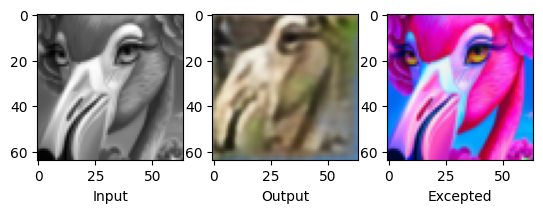

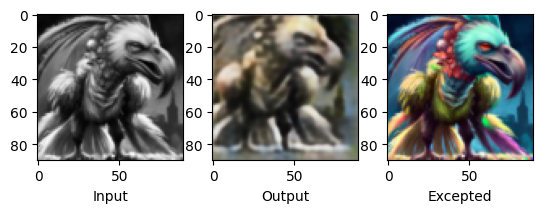

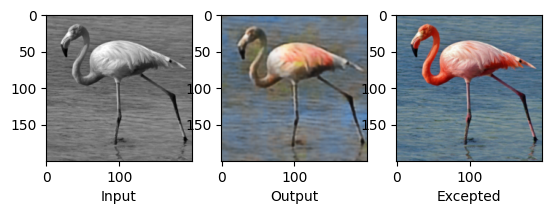

In [18]:
test(colorWizard6)

### Momentum = 0.8:

In [20]:
colorWizard7 = Autoenkoder(4, 0.8)
colorWizard7.compile(optimizer=Adam(0.006), loss=mse)

In [21]:
_ = colorWizard7.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
45/45 [==============================] - 23s 481ms/step - loss: 0.0308 - val_loss: 0.0201 - lr: 0.0060
Epoch 2/160
45/45 [==============================] - 21s 466ms/step - loss: 0.0194 - val_loss: 0.0197 - lr: 0.0060
Epoch 3/160
45/45 [==============================] - 21s 467ms/step - loss: 0.0169 - val_loss: 0.0160 - lr: 0.0060
Epoch 4/160
45/45 [==============================] - 21s 468ms/step - loss: 0.0156 - val_loss: 0.0154 - lr: 0.0060
Epoch 5/160
45/45 [==============================] - 21s 468ms/step - loss: 0.0150 - val_loss: 0.0138 - lr: 0.0060
Epoch 6/160
45/45 [==============================] - 21s 468ms/step - loss: 0.0134 - val_loss: 0.0136 - lr: 0.0060
Epoch 7/160
45/45 [==============================] - 21s 469ms/step - loss: 0.0136 - val_loss: 0.0161 - lr: 0.0060
Epoch 8/160
45/45 [==============================] - 21s 469ms/step - loss: 0.0124 - val_loss: 0.0125 - lr: 0.0060
Epoch 9/160
45/45 [==============================] - 21s 470ms/step - loss: 0.01

3/3 [==============================] - 5s 28ms/step - loss: 0.0000e+00
test loss, test acc: 0.0
1/1 [==============================] - 0s 22ms/step


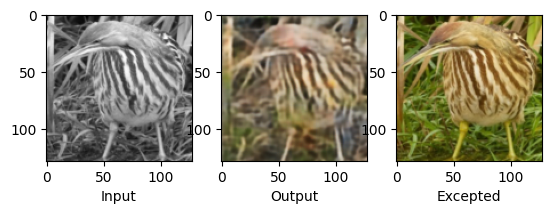

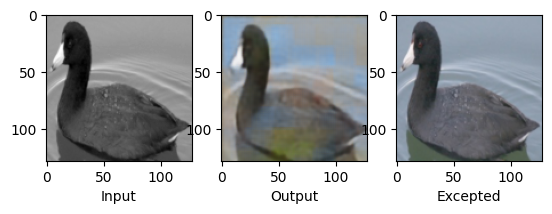

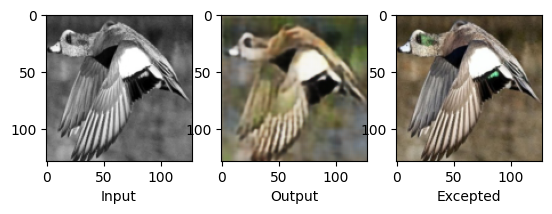

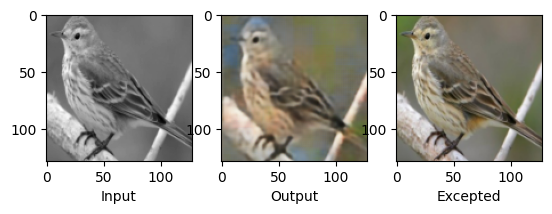

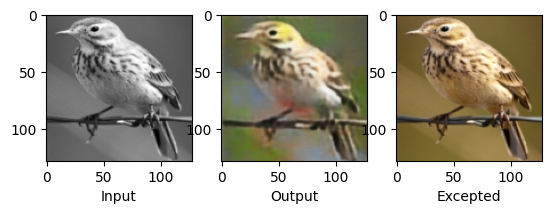

...

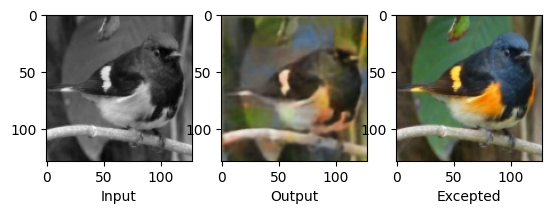

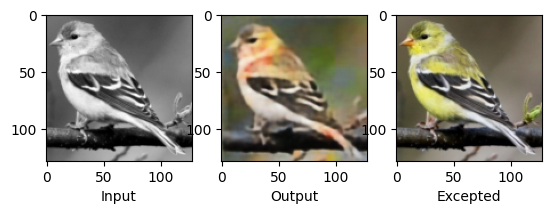

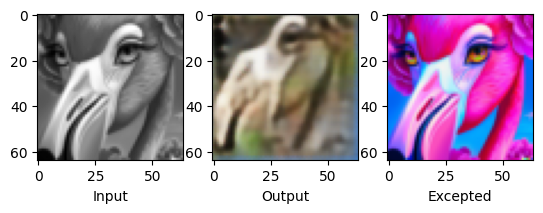

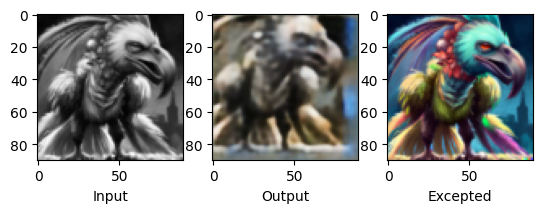

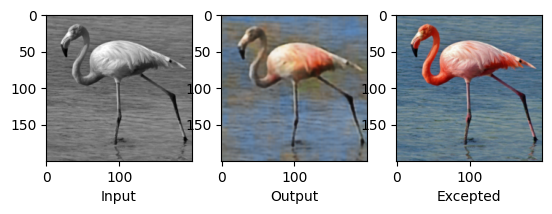

In [22]:
test(colorWizard7)

### Komentarz 
Momentum równe 0.9 osiągnęło najlepsze wyniki.

# Weight decay:
### Weight deacy 0.01:

In [13]:
colorWizard8 = Autoenkoder(4, 0.9, 0.01)
colorWizard8.compile(optimizer=Adam(0.006), loss=mse)

In [14]:
_ = colorWizard8.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
91/91 [==============================] - 25s 254ms/step - loss: 0.3732 - val_loss: 0.1653 - lr: 0.0060
Epoch 2/160
91/91 [==============================] - 23s 251ms/step - loss: 0.1117 - val_loss: 0.1096 - lr: 0.0060
Epoch 3/160
91/91 [==============================] - 23s 248ms/step - loss: 0.0768 - val_loss: 0.1709 - lr: 0.0060
Epoch 4/160
91/91 [==============================] - 23s 250ms/step - loss: 0.1048 - val_loss: 0.1510 - lr: 0.0060
Epoch 5/160
91/91 [==============================] - 23s 251ms/step - loss: 0.0703 - val_loss: 0.0561 - lr: 0.0060
Epoch 6/160
91/91 [==============================] - 23s 250ms/step - loss: 0.1653 - val_loss: 0.3033 - lr: 0.0060
Epoch 7/160
91/91 [==============================] - 23s 250ms/step - loss: 0.0823 - val_loss: 0.0426 - lr: 0.0060
Epoch 8/160
91/91 [==============================] - 23s 250ms/step - loss: 0.0368 - val_loss: 0.0697 - lr: 0.0060
Epoch 9/160
91/91 [==============================] - 23s 251ms/step - loss: 0.05

3/3 [==============================] - 0s 13ms/step - loss: 1.5060e-04
test loss, test acc: 0.0001506013359175995
1/1 [==============================] - 0s 23ms/step


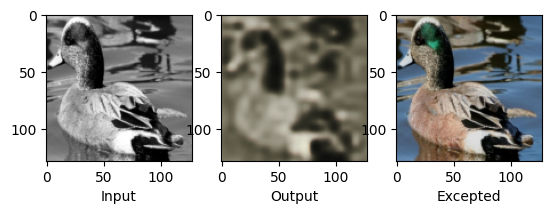

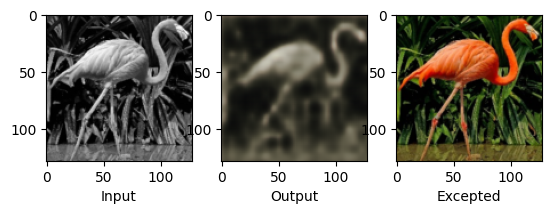

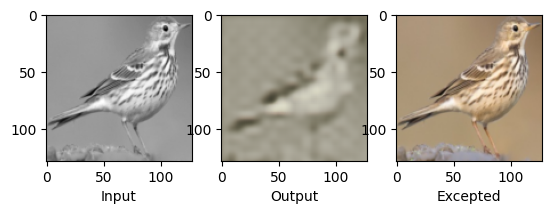

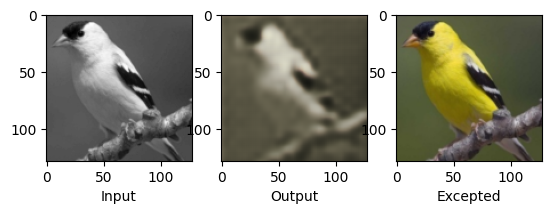

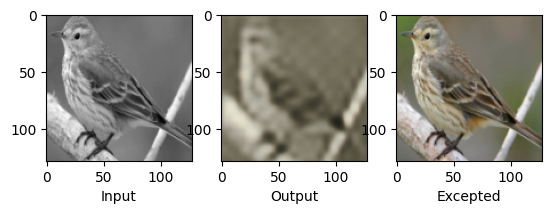

...

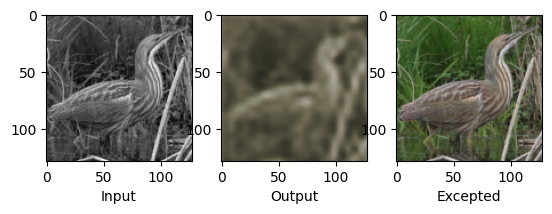

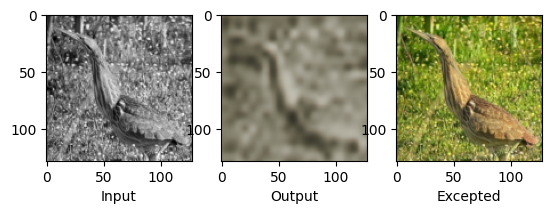

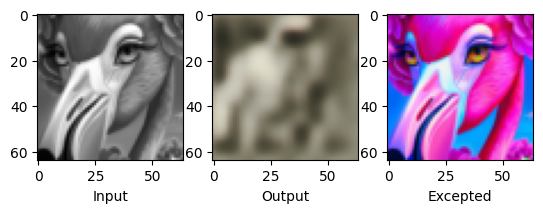

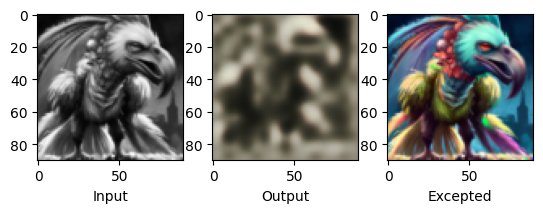

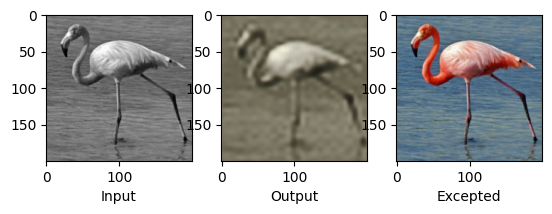

In [15]:
test(colorWizard8)

### Weight deacy 0.001

In [16]:
colorWizard9 = Autoenkoder(4, 0.9, 0.001)
colorWizard9.compile(optimizer=Adam(0.006), loss=mse)

In [17]:
_ = colorWizard9.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
91/91 [==============================] - 25s 260ms/step - loss: 0.0808 - val_loss: 0.0572 - lr: 0.0060
Epoch 2/160
91/91 [==============================] - 23s 254ms/step - loss: 0.0392 - val_loss: 0.0422 - lr: 0.0060
Epoch 3/160
91/91 [==============================] - 23s 252ms/step - loss: 0.0355 - val_loss: 0.0565 - lr: 0.0060
Epoch 4/160
91/91 [==============================] - 23s 251ms/step - loss: 0.0379 - val_loss: 0.0429 - lr: 0.0060
Epoch 5/160
91/91 [==============================] - 23s 252ms/step - loss: 0.0288 - val_loss: 0.0440 - lr: 0.0060
Epoch 6/160
91/91 [==============================] - 23s 252ms/step - loss: 0.0298 - val_loss: 0.0407 - lr: 0.0060
Epoch 7/160
91/91 [==============================] - 23s 252ms/step - loss: 0.0247 - val_loss: 0.0385 - lr: 0.0060
Epoch 8/160
91/91 [==============================] - 23s 252ms/step - loss: 0.0227 - val_loss: 0.0286 - lr: 0.0060
Epoch 9/160
91/91 [==============================] - 23s 252ms/step - loss: 0.02

3/3 [==============================] - 26s 121ms/step - loss: 1.3485e-04
test loss, test acc: 0.00013484532246366143
1/1 [==============================] - 0s 69ms/step


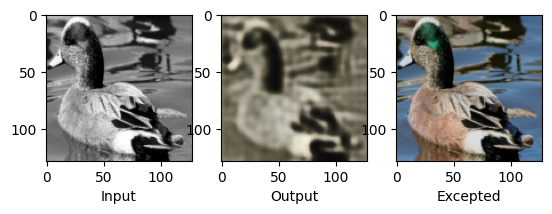

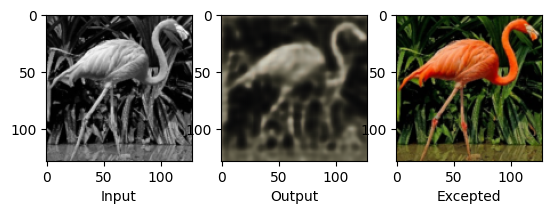

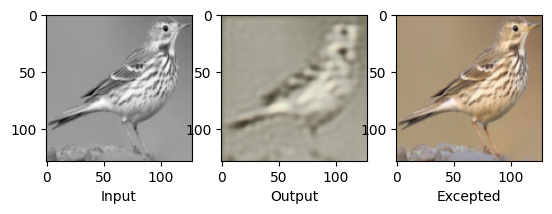

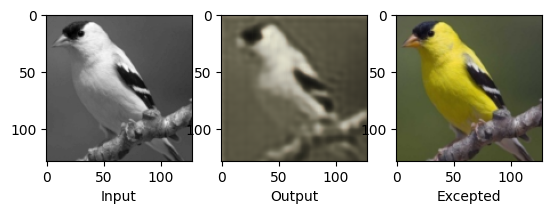

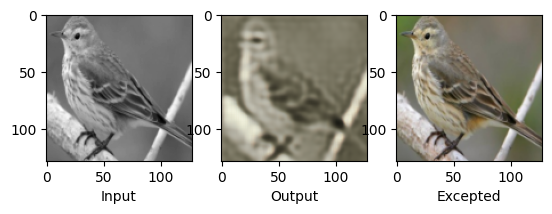

...

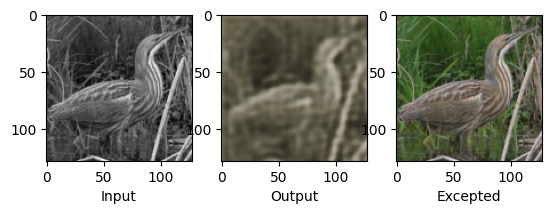

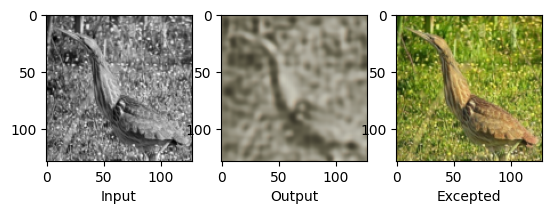

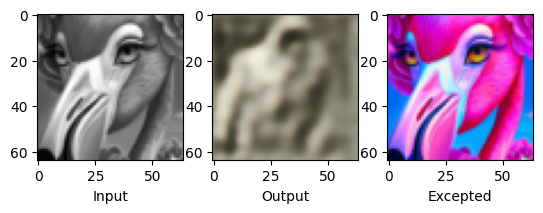

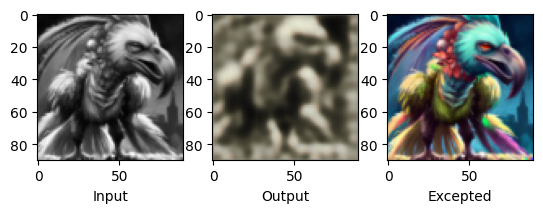

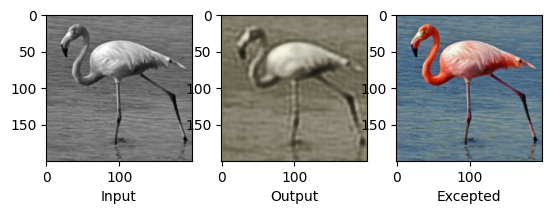

In [18]:
test(colorWizard9)

### Weight deacy 0.0001:

In [5]:
colorWizard10 = Autoenkoder(4, 0.9, 0.0001)
colorWizard10.compile(optimizer=Adam(0.006), loss=mse)

In [6]:
_ = colorWizard10.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
91/91 [==============================] - 28s 264ms/step - loss: 0.0409 - val_loss: 0.0307 - lr: 0.0060
Epoch 2/160
91/91 [==============================] - 22s 238ms/step - loss: 0.0261 - val_loss: 0.0219 - lr: 0.0060
Epoch 3/160
91/91 [==============================] - 22s 239ms/step - loss: 0.0213 - val_loss: 0.0341 - lr: 0.0060
Epoch 4/160
91/91 [==============================] - 22s 238ms/step - loss: 0.0199 - val_loss: 0.0227 - lr: 0.0060
Epoch 5/160
91/91 [==============================] - 22s 239ms/step - loss: 0.0185 - val_loss: 0.0176 - lr: 0.0060
Epoch 6/160
91/91 [==============================] - 22s 239ms/step - loss: 0.0183 - val_loss: 0.0205 - lr: 0.0060
Epoch 7/160
91/91 [==============================] - 22s 238ms/step - loss: 0.0176 - val_loss: 0.0203 - lr: 0.0060
Epoch 8/160
91/91 [==============================] - 22s 239ms/step - loss: 0.0167 - val_loss: 0.0164 - lr: 0.0060
Epoch 9/160
91/91 [==============================] - 22s 238ms/step - loss: 0.01

3/3 [==============================] - 1s 31ms/step - loss: 2.1991e-04
test loss, test acc: 0.00021990633103996515
1/1 [==============================] - 0s 350ms/step


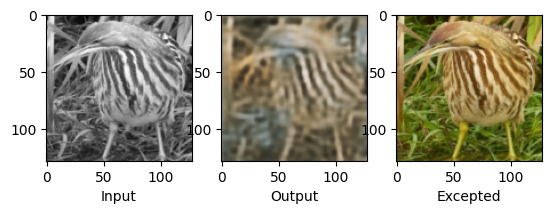

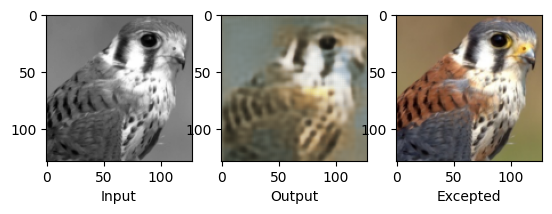

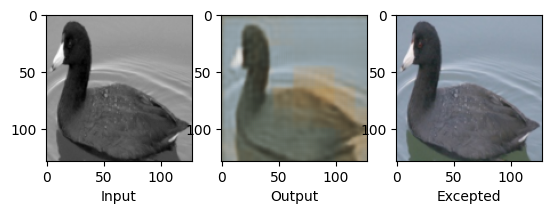

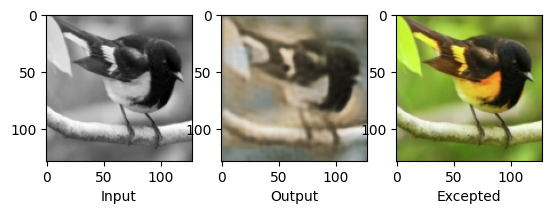

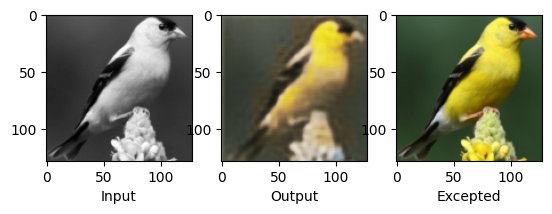

...

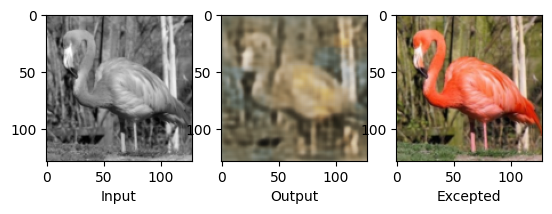

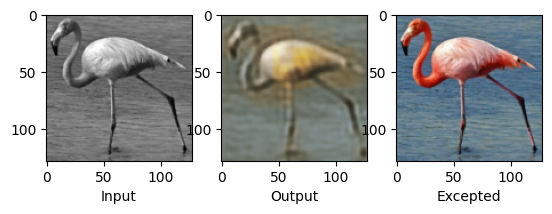

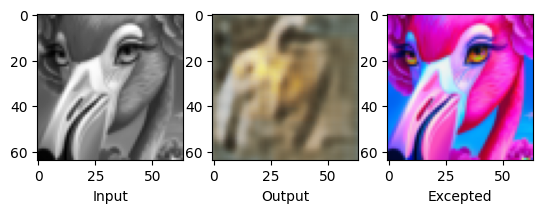

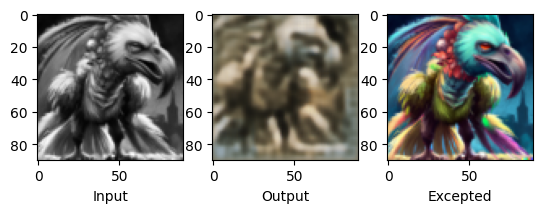

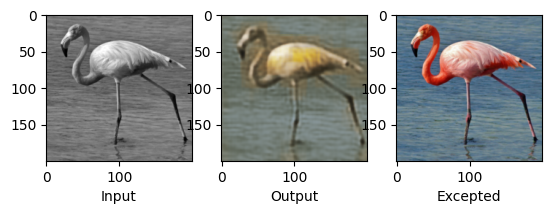

In [7]:
test(colorWizard10)

### Weight deacy 0.00001:

In [8]:
colorWizard11 = Autoenkoder(4, 0.9, 0.00001)
colorWizard11.compile(optimizer=Adam(0.006), loss=mse)

In [9]:
_ = colorWizard11.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
91/91 [==============================] - 24s 247ms/step - loss: 0.0362 - val_loss: 0.0272 - lr: 0.0060
Epoch 2/160
91/91 [==============================] - 22s 244ms/step - loss: 0.0196 - val_loss: 0.0189 - lr: 0.0060
Epoch 3/160
91/91 [==============================] - 22s 242ms/step - loss: 0.0181 - val_loss: 0.0209 - lr: 0.0060
Epoch 4/160
91/91 [==============================] - 22s 241ms/step - loss: 0.0166 - val_loss: 0.0163 - lr: 0.0060
Epoch 5/160
91/91 [==============================] - 22s 241ms/step - loss: 0.0156 - val_loss: 0.0155 - lr: 0.0060
Epoch 6/160
91/91 [==============================] - 22s 241ms/step - loss: 0.0149 - val_loss: 0.0168 - lr: 0.0060
Epoch 7/160
91/91 [==============================] - 22s 241ms/step - loss: 0.0148 - val_loss: 0.0146 - lr: 0.0060
Epoch 8/160
91/91 [==============================] - 22s 241ms/step - loss: 0.0155 - val_loss: 0.0179 - lr: 0.0060
Epoch 9/160
91/91 [==============================] - 22s 241ms/step - loss: 0.01

3/3 [==============================] - 1s 35ms/step - loss: 3.6749e-04
test loss, test acc: 0.00036748999264091253
1/1 [==============================] - 0s 34ms/step


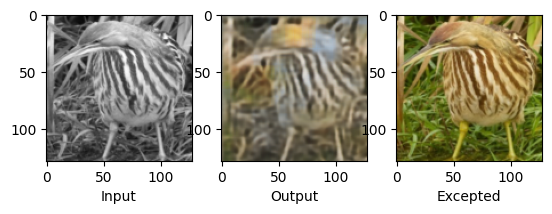

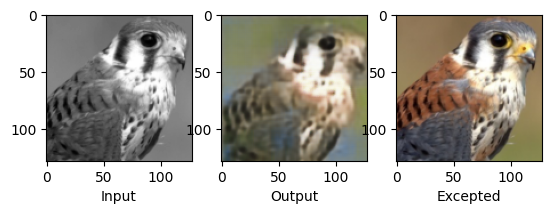

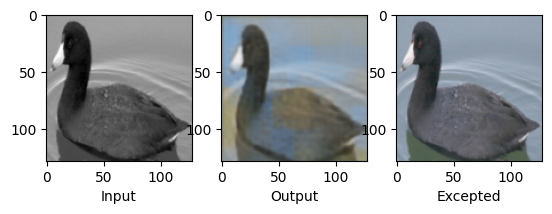

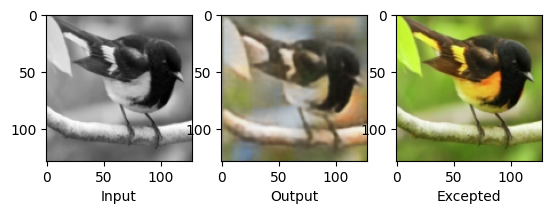

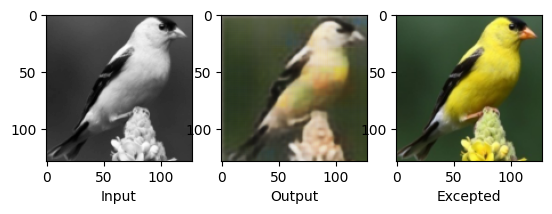

...

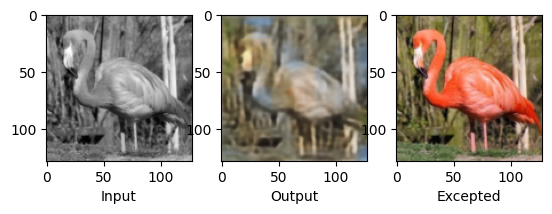

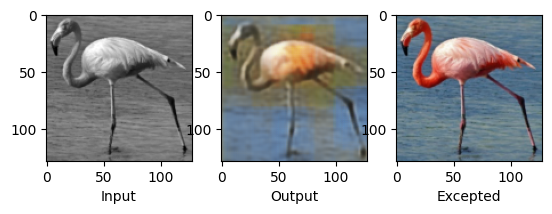

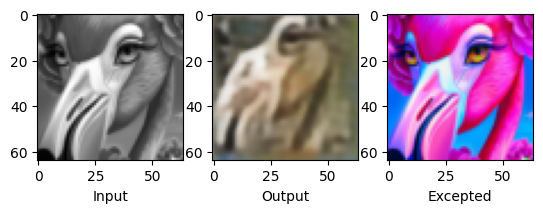

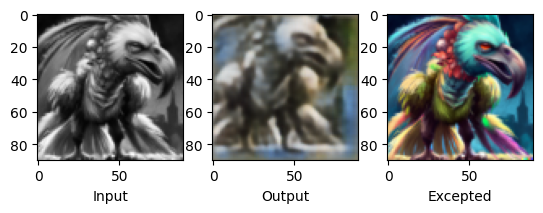

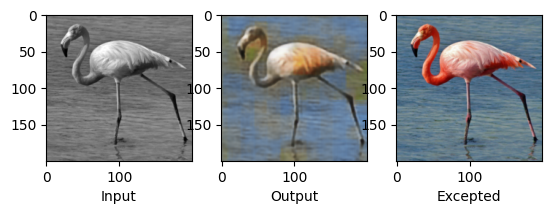

In [10]:
test(colorWizard11)

### Weight deacy 0.000001:

In [11]:
colorWizard12 = Autoenkoder(4, 0.9, 0.000001)
colorWizard12.compile(optimizer=Adam(0.006), loss=mse)

In [13]:
_ = colorWizard12.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=160, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 6, factor = 0.66, verbose=True, min_delta=0.0000001, min_lr=0.00001)])

Epoch 1/160
91/91 [==============================] - 22s 236ms/step - loss: 0.0167 - val_loss: 0.0163 - lr: 0.0060
Epoch 2/160
91/91 [==============================] - 22s 237ms/step - loss: 0.0151 - val_loss: 0.0143 - lr: 0.0060
Epoch 3/160
91/91 [==============================] - 22s 245ms/step - loss: 0.0143 - val_loss: 0.0233 - lr: 0.0060
Epoch 4/160
91/91 [==============================] - 22s 239ms/step - loss: 0.0138 - val_loss: 0.0148 - lr: 0.0060
Epoch 5/160
91/91 [==============================] - 22s 239ms/step - loss: 0.0140 - val_loss: 0.0130 - lr: 0.0060
Epoch 6/160
91/91 [==============================] - 22s 239ms/step - loss: 0.0132 - val_loss: 0.0125 - lr: 0.0060
Epoch 7/160
91/91 [==============================] - 22s 239ms/step - loss: 0.0130 - val_loss: 0.0157 - lr: 0.0060
Epoch 8/160
91/91 [==============================] - 22s 238ms/step - loss: 0.0128 - val_loss: 0.0122 - lr: 0.0060
Epoch 9/160
91/91 [==============================] - 22s 239ms/step - loss: 0.01

3/3 [==============================] - 3s 43ms/step - loss: 3.4566e-04
test loss, test acc: 0.00034565720125101507
1/1 [==============================] - 0s 60ms/step


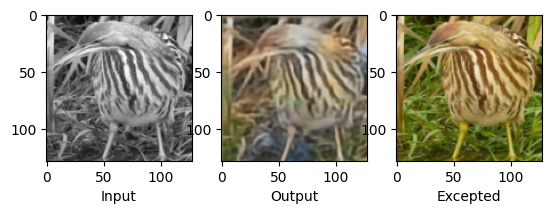

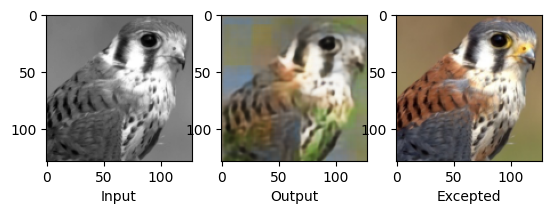

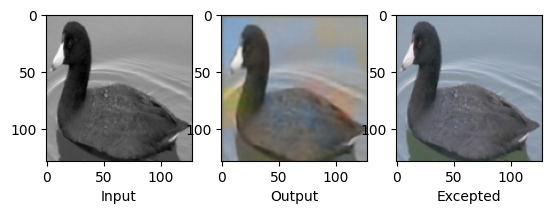

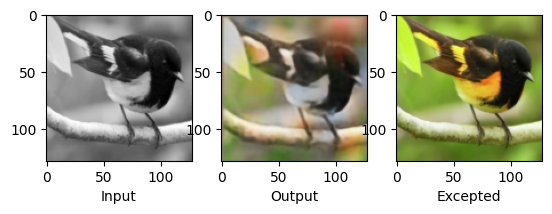

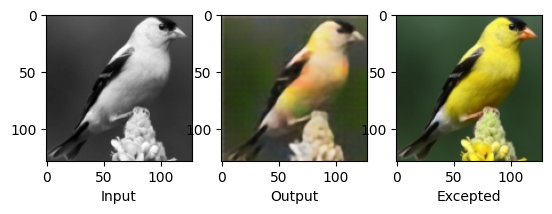

...

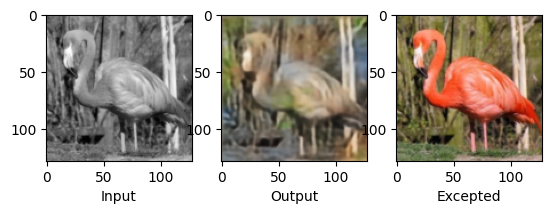

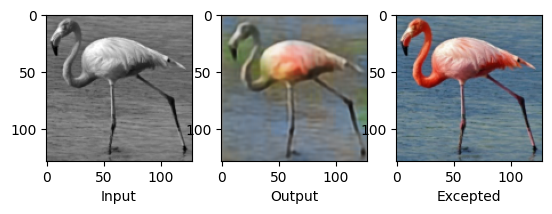

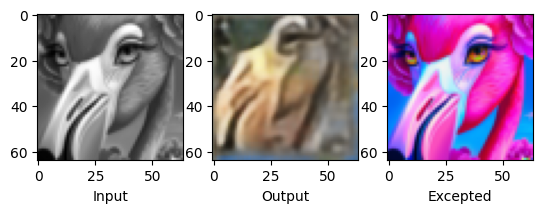

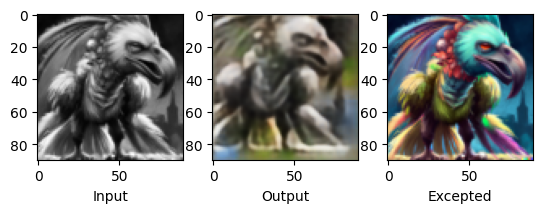

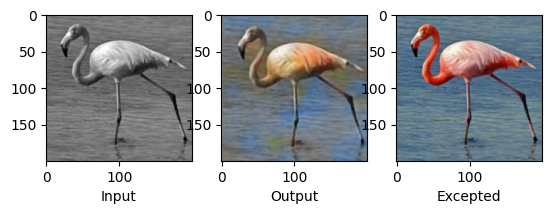

In [14]:
test(colorWizard12)

### Komentarz
Mimo, że wyniki są nieco gorsze, to widać większą ciągłość w kolorach i flamingi są pokolorowane nieco lepiej. Domyślamy się, że przy dłuższym uczeniu sieci (a jeszcze lepiej - większym zbiorze uczącym), modele posiadające weight decay wypadłyby lepiej. Do uczenia naszej finalnej sieci wykorzystamy ostatni model.

# Najlepsza sieć
Potrenujemy ją trochę dłużej i dobierzemy lepsze (a przynajmniej takie, który wydają nam się lepsze) parametry uczenia.

In [6]:
colorWizard13 = Autoenkoder(4, 0.9, 0.000001)
colorWizard13.compile(optimizer=Adam(0.0005), loss=mse)

In [7]:
print("150/600")
_ = colorWizard13.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=150, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 9, factor = 0.75, verbose=True, min_delta=0.0000001, min_lr=0.000008)])

150/600
Epoch 1/150
91/91 [==============================] - 28s 263ms/step - loss: 0.0207 - val_loss: 0.0152 - lr: 5.0000e-04
Epoch 2/150
91/91 [==============================] - 22s 236ms/step - loss: 0.0146 - val_loss: 0.0131 - lr: 5.0000e-04
Epoch 3/150
91/91 [==============================] - 22s 238ms/step - loss: 0.0132 - val_loss: 0.0128 - lr: 5.0000e-04
Epoch 4/150
91/91 [==============================] - 22s 239ms/step - loss: 0.0124 - val_loss: 0.0122 - lr: 5.0000e-04
Epoch 5/150
91/91 [==============================] - 22s 239ms/step - loss: 0.0115 - val_loss: 0.0111 - lr: 5.0000e-04
Epoch 6/150
91/91 [==============================] - 22s 239ms/step - loss: 0.0116 - val_loss: 0.0112 - lr: 5.0000e-04
Epoch 7/150
91/91 [==============================] - 22s 240ms/step - loss: 0.0115 - val_loss: 0.0114 - lr: 5.0000e-04
Epoch 8/150
91/91 [==============================] - 22s 240ms/step - loss: 0.0106 - val_loss: 0.0107 - lr: 5.0000e-04
Epoch 9/150
91/91 [=====================

3/3 [==============================] - 2s 40ms/step - loss: 3.7184e-04
test loss, test acc: 0.0003718441294040531
1/1 [==============================] - 0s 360ms/step


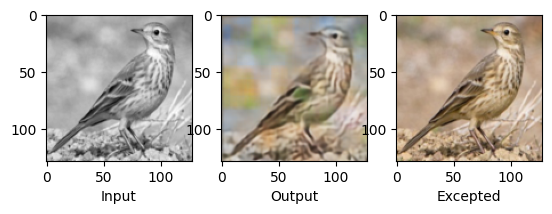

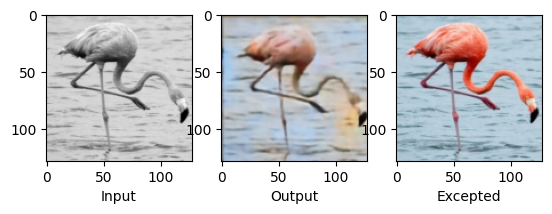

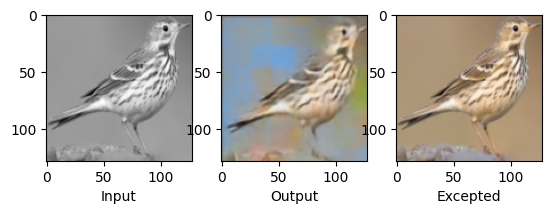

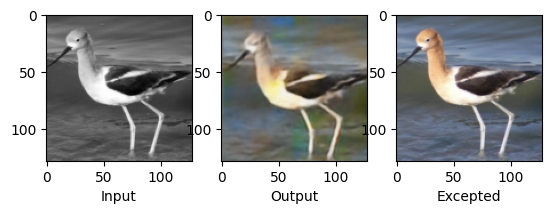

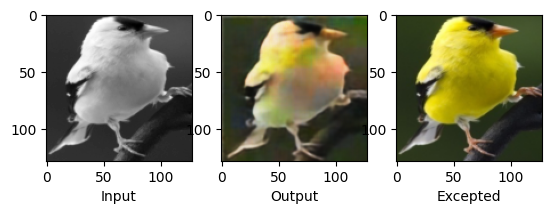

...

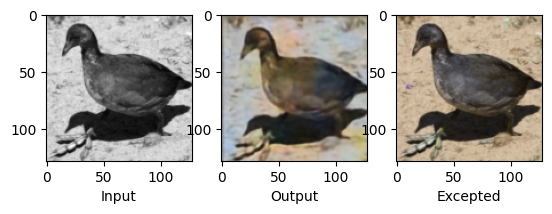

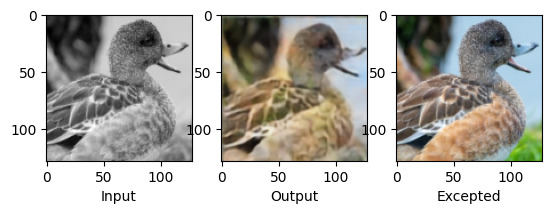

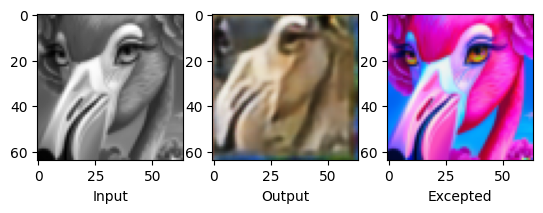

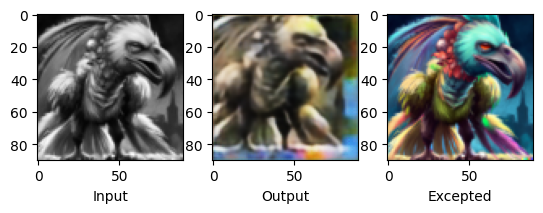

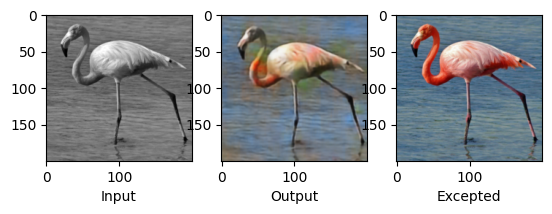

In [8]:
test(colorWizard13)

In [9]:
print("300/600")
_ = colorWizard13.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=150, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 9, factor = 0.75, verbose=True, min_delta=0.0000001, min_lr=0.000008)])

300/600
Epoch 1/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0026 - val_loss: 0.0089 - lr: 3.7542e-05
Epoch 2/150
91/91 [==============================] - 22s 239ms/step - loss: 0.0026 - val_loss: 0.0089 - lr: 3.7542e-05
Epoch 3/150
91/91 [==============================] - 22s 240ms/step - loss: 0.0026 - val_loss: 0.0089 - lr: 3.7542e-05
Epoch 4/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0026 - val_loss: 0.0088 - lr: 3.7542e-05
Epoch 5/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0026 - val_loss: 0.0088 - lr: 3.7542e-05
Epoch 6/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0026 - val_loss: 0.0088 - lr: 3.7542e-05
Epoch 7/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0026 - val_loss: 0.0089 - lr: 3.7542e-05
Epoch 8/150
91/91 [==============================] - 25s 274ms/step - loss: 0.0026 - val_loss: 0.0089 - lr: 3.7542e-05
Epoch 9/150
91/91 [=====================

3/3 [==============================] - 0s 35ms/step - loss: 3.2261e-04
test loss, test acc: 0.00032261197338812053
1/1 [==============================] - 0s 24ms/step


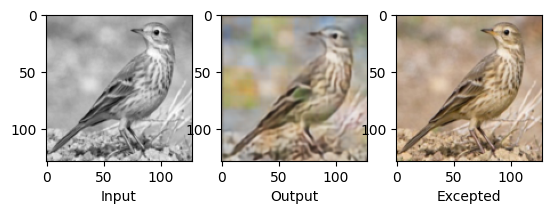

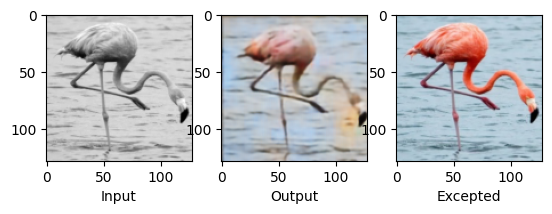

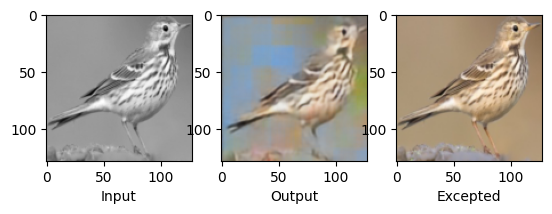

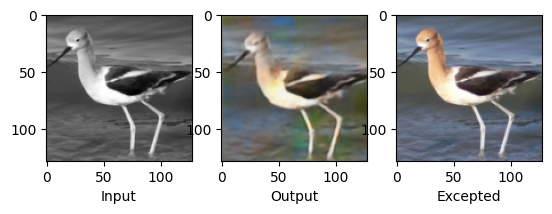

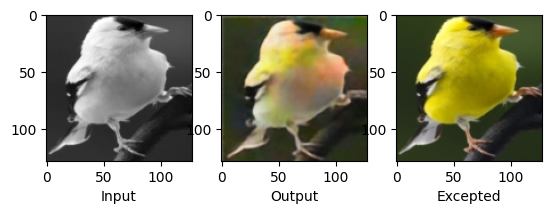

...

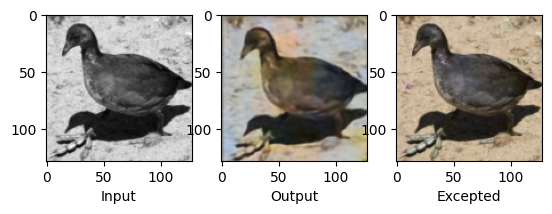

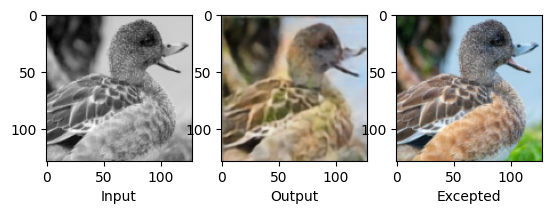

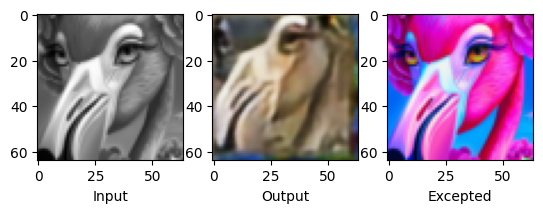

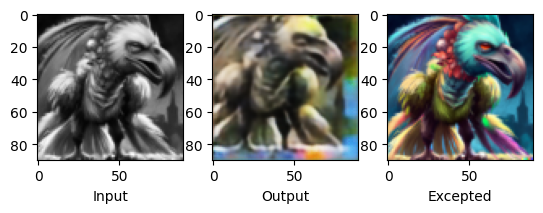

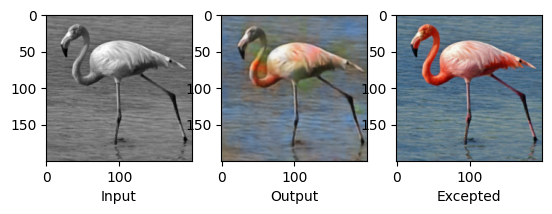

In [10]:
test(colorWizard13)

In [11]:
print("450/600")
_ = colorWizard13.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=150, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 9, factor = 0.75, verbose=True, min_delta=0.0000001, min_lr=0.000008)])

450/600
Epoch 1/150
91/91 [==============================] - 22s 245ms/step - loss: 0.0023 - val_loss: 0.0088 - lr: 8.0000e-06
Epoch 2/150
91/91 [==============================] - 22s 240ms/step - loss: 0.0023 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 3/150
91/91 [==============================] - 22s 240ms/step - loss: 0.0024 - val_loss: 0.0088 - lr: 8.0000e-06
Epoch 4/150
91/91 [==============================] - 22s 242ms/step - loss: 0.0024 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 5/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0023 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 6/150
91/91 [==============================] - 22s 240ms/step - loss: 0.0024 - val_loss: 0.0088 - lr: 8.0000e-06
Epoch 7/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0023 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 8/150
91/91 [==============================] - 22s 243ms/step - loss: 0.0024 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 9/150
91/91 [=====================

3/3 [==============================] - 0s 35ms/step - loss: 2.9688e-04
test loss, test acc: 0.00029687967617064714
1/1 [==============================] - 0s 22ms/step


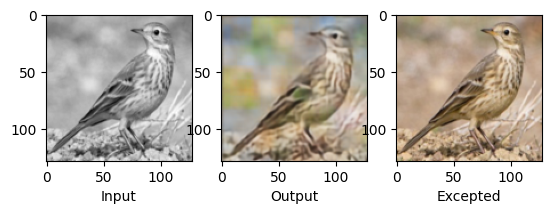

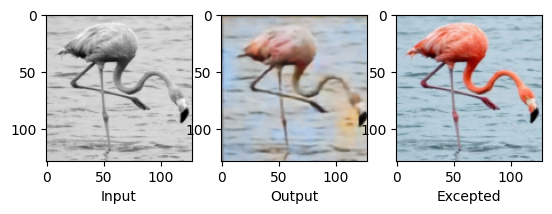

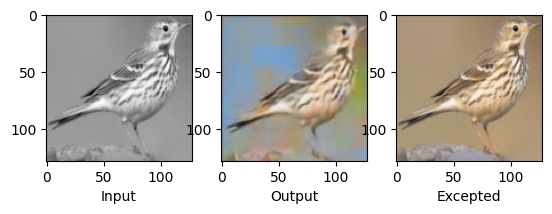

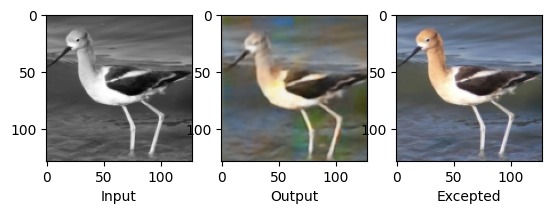

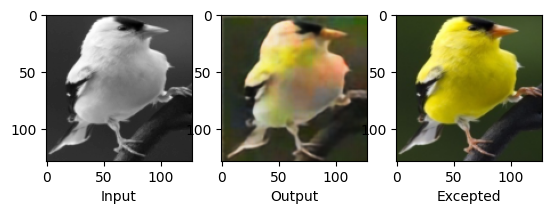

...

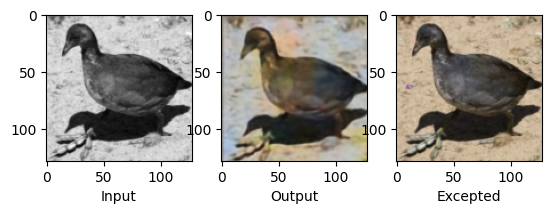

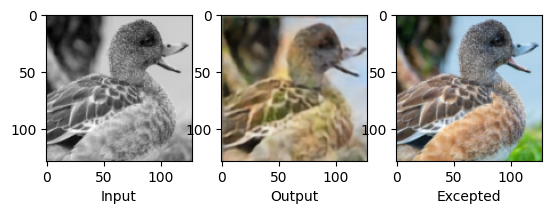

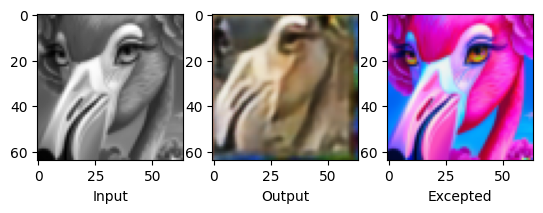

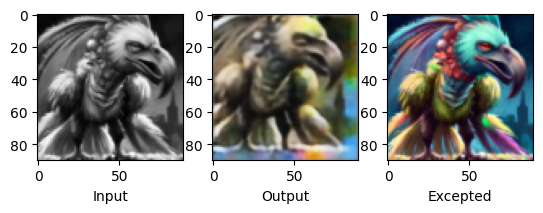

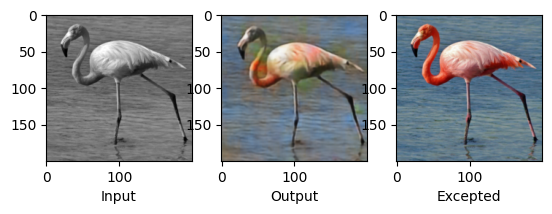

In [12]:
test(colorWizard13)

In [13]:
print("600/600")
_ = colorWizard13.fit(trainAmericanGenerator,
                steps_per_epoch=STEPS_AMERICA,
                epochs=150, 
                validation_data=validAmericanGenerator,
                validation_steps=VAL_STEPS_AMERICA,
                callbacks=[ReduceLROnPlateau(patience = 9, factor = 0.75, verbose=True, min_delta=0.0000001, min_lr=0.000008)])

600/600
Epoch 1/150
91/91 [==============================] - 22s 243ms/step - loss: 0.0022 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 2/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0023 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 3/150
91/91 [==============================] - 22s 244ms/step - loss: 0.0022 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 4/150
91/91 [==============================] - 22s 242ms/step - loss: 0.0022 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 5/150
91/91 [==============================] - 22s 243ms/step - loss: 0.0022 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 6/150
91/91 [==============================] - 23s 249ms/step - loss: 0.0022 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 7/150
91/91 [==============================] - 22s 241ms/step - loss: 0.0022 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 8/150
91/91 [==============================] - 22s 242ms/step - loss: 0.0022 - val_loss: 0.0087 - lr: 8.0000e-06
Epoch 9/150
91/91 [=====================

3/3 [==============================] - 0s 27ms/step - loss: 2.7481e-04
test loss, test acc: 0.00027481428696773946
1/1 [==============================] - 0s 36ms/step


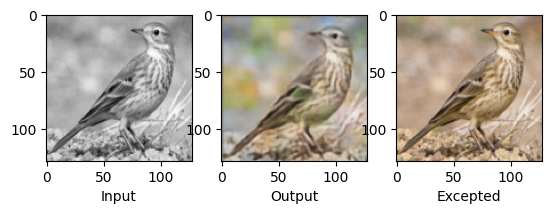

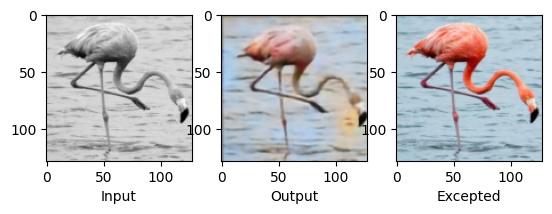

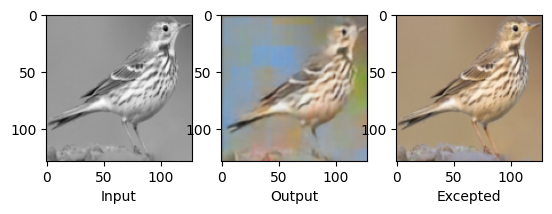

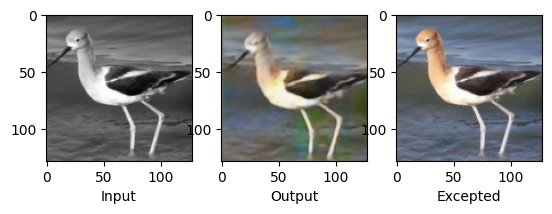

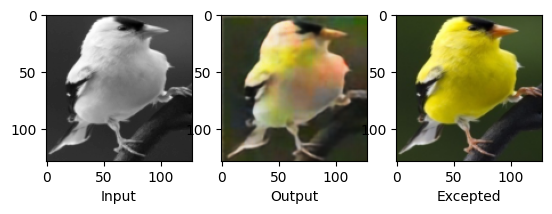

...

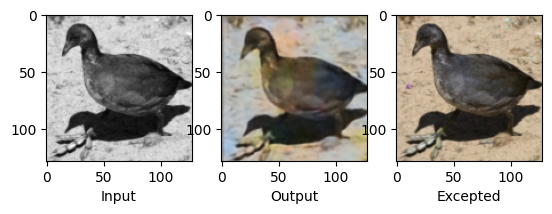

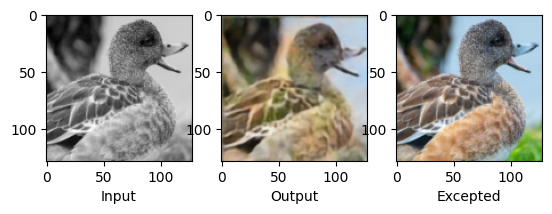

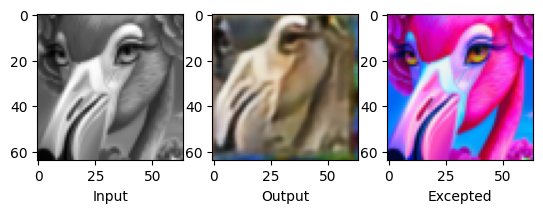

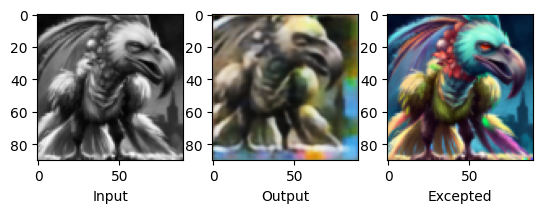

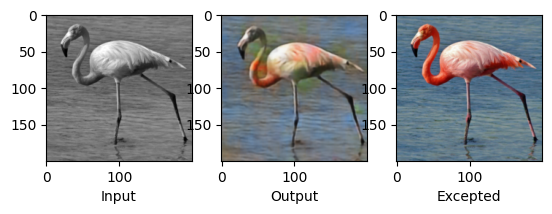

In [14]:
test(colorWizard13)